#**ID: 312141369**

#**Question 1**

#Environment Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [47]:
!pip install turicreate
!pip install plotly --upgrade
!pip install networkx
!mkdir ./images
!mkdir ./videos
!pip install -U kaleido

     |████████████████████████████████| 79.9 MB 127 kB/s 


In [2]:
!pip install turicreate
!pip install plotly --upgrade

     |████████████████████████████████| 92.0 MB 13 kB/s 
     |████████████████████████████████| 3.5 MB 62.8 MB/s 
     |████████████████████████████████| 86.4 MB 80 kB/s 
     |████████████████████████████████| 3.6 MB 47.3 MB/s 
     |████████████████████████████████| 322 kB 60.7 MB/s 
     |████████████████████████████████| 18.3 MB 76.0 MB/s 
     |████████████████████████████████| 449 kB 75.3 MB/s 
     |████████████████████████████████| 2.9 MB 54.3 MB/s 
     |████████████████████████████████| 50 kB 9.0 MB/s 
     |████████████████████████████████| 3.8 MB 49.0 MB/s 
     |████████████████████████████████| 20.1 MB 1.2 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=29199dc24f01bab91ad808b44237e1026abbfe8a649684aa165a3fa6b2d0073e
  Stored in directory: /root/.cache/pip/wheels/b2/7f/f6/f180315b584f00445045ff1699b550fa895d09471337ce21c6
  Created wheel for resampy: filename=resampy-0.2.1-py3-none-any.whl size=320859 sha256=2f17f07973

In [3]:
!mkdir Datasets
data_path = "./Datasets"

# Data Collection & Preparation

## State-level Data

State-level data is aquired based on instructions from https://covidtracking.com/analysis-updates/federal-covid-data-single-stream, and is an adapted form of their manual "Federal COVID Data in a Single Stream" (https://colab.research.google.com/github/COVID19Tracking/covid-tracking-data/blob/master/data-collection-scripts/federal-data-combiner/combine.ipynb) 

###Setup

In [4]:
import turicreate as tc
from bs4 import BeautifulSoup
import requests
import re
import pandas as pd
import datetime
import sys
import pytz

"""Federal data combiner tool. Downloads federal testing, hospitalization, and case/death data and combines it
into unified state-level output. 
"""

HHS_TESTING_URL = "https://www.healthdata.gov/api/views/j8mb-icvb/rows.csv?accessType=DOWNLOAD"
# Source: https://beta.healthdata.gov/Hospital/COVID-19-Reported-Patient-Impact-and-Hospital-Capa/g62h-syeh
HHS_HOSPITALIZATION_URL = "https://www.healthdata.gov/api/views/g62h-syeh/rows.csv?accessType=DOWNLOAD"
HHS_HOSPITALIZATION_REVISIONS_URL = "https://www.healthdata.gov/api/views/4cnb-m4rz/rows.csv?accessType=DOWNLOAD"
# Source: https://data.cdc.gov/Case-Surveillance/United-States-COVID-19-Cases-and-Deaths-by-State-o/9mfq-cb36
CDC_CASE_DEATH_URL = "https://data.cdc.gov/api/views/9mfq-cb36/rows.csv?accessType=DOWNLOAD"
COMBINE_NY_NYC = True


def get_hospitalization_csv_urls():
    """get a set of recent revisions for the HHS hospitalizations-by-state dataset"""
    revisions = pd.read_csv(HHS_HOSPITALIZATION_REVISIONS_URL)

    revisions['Update Date'] = pd.to_datetime(revisions['Update Date'], format='%m/%d/%Y %H:%M:%S %p')
    return revisions.sort_values(by=['Update Date']).tail(n=8)['Archive Link'].tolist()


def get_hospitalization_dailies():
    """build a dataframe containing the combination of several days of recent HHS hospitalization daily data"""
    csv_urls = get_hospitalization_csv_urls()
    data_frames = []

    for url in csv_urls:
        data = pd.read_csv(url, parse_dates=['reporting_cutoff_start'])
        # set each daily file's date to the reporting_cutoff_start date + 4 days
        data['date'] = data['reporting_cutoff_start'] + pd.DateOffset(days=4)
        data['date'] = data['date'].dt.date
        data_frames.append(data)
    hospitalization_dailies = pd.concat(data_frames)
    return hospitalization_dailies


def parse_dates(date_col):
  if date_col.str.contains(":").any():
    return pd.to_datetime(date_col, format='%m/%d/%Y %H:%M:%S %p').dt.date
  else: 
    return pd.to_datetime(date_col, format='%Y-%m-%d').dt.date

### Data Download

In [5]:
# download and parse all three data files
[testing, hospitalization, case_death] = [pd.read_csv(url) for url in
                                          [HHS_TESTING_URL, HHS_HOSPITALIZATION_URL, CDC_CASE_DEATH_URL]]

### Preperation

#### Testing

In [6]:
# testing data comes out with one row per state/date/outcome combination.
# unpack that and squash it into one row per state/date only
testing = testing.set_index(['state', 'date', 'overall_outcome']).unstack(level=-1)
testing = testing[['new_results_reported', 'total_results_reported']]
testing.columns = ['_'.join(tup).rstrip('_') for tup in testing.columns.values]
testing = testing.reset_index()
# allow for a choice of inconsistent datetime formats
testing['date'] = parse_dates(testing['date'])

#### Hospitalization

In [7]:
# the HHS hospitalization time series is only updated weekly. To compensate, we download the latest daily data
# and merge it on top of the weekly data, taking only the most recent values for a given state/date
hospitalization['date'] = parse_dates(hospitalization['date'])
hospitalization_dailies = get_hospitalization_dailies()
# we want to use the HHS weekly time series up until its last day, then fill in the rest of the data from the daily
# files. we overwrite the last day of the time series with the dailies because the dailies come out after the weekly
hospitalization_dailies = hospitalization_dailies[hospitalization_dailies['date'] >= hospitalization['date'].max()]

hospitalization.set_index(['state', 'date'])
# don't break everything with missing values in geocoded_state
hospitalization_dailies['geocoded_state'] = hospitalization_dailies['geocoded_state'].fillna("")
hospitalization['geocoded_state'] = hospitalization['geocoded_state'].fillna("")
# and merge the weekly and dailies
hospitalization = hospitalization.merge(hospitalization_dailies, how='outer')
# the keep='last' here keeps just the daily data when both duplicate weekly and daily data exist
hospitalization = hospitalization.drop_duplicates(subset=['date', 'state'], keep='last', ignore_index=True)
# select a subset of columns to include in the output
hospitalization = hospitalization[[
    'state',
    'date', 
    'critical_staffing_shortage_today_yes',
    'inpatient_beds_used_covid',
    'adult_icu_bed_utilization',
    'total_adult_patients_hospitalized_confirmed_and_suspected_covid',
    'total_adult_patients_hospitalized_confirmed_covid',
    'total_pediatric_patients_hospitalized_confirmed_and_suspected_covid',
    'total_pediatric_patients_hospitalized_confirmed_covid',
    'staffed_icu_adult_patients_confirmed_and_suspected_covid',
    'staffed_icu_adult_patients_confirmed_covid',
    'previous_day_admission_adult_covid_confirmed', 
    'previous_day_admission_adult_covid_suspected',
    'previous_day_admission_pediatric_covid_confirmed',
    'previous_day_admission_pediatric_covid_suspected',
    'inpatient_beds_used_covid_coverage',
    'total_adult_patients_hospitalized_confirmed_and_suspected_covid_coverage',
    'staffed_icu_adult_patients_confirmed_and_suspected_covid_coverage',
    'previous_day_admission_adult_covid_confirmed_coverage',
    'previous_day_admission_adult_covid_confirmed_18-19',
    'previous_day_admission_adult_covid_confirmed_20-29',
    'previous_day_admission_adult_covid_confirmed_30-39',
    'previous_day_admission_adult_covid_confirmed_40-49',
    'previous_day_admission_adult_covid_confirmed_50-59',
    'previous_day_admission_adult_covid_confirmed_60-69',
    'previous_day_admission_adult_covid_confirmed_70-79',
    'previous_day_admission_adult_covid_confirmed_80+',
    'previous_day_admission_adult_covid_confirmed_unknown']]
# HHS hospitalization data gets better on and after 7/15/20
hospitalization = hospitalization[hospitalization['date'] >= datetime.date(year=2020,month=7,day=15)]

####Cases & Deaths

In [8]:
# case/death data: pick a subset of columns and prepare to merge
case_death = case_death[
    ['submission_date', 'state', 'tot_cases', 'conf_cases', 'prob_cases', 'new_case', 'pnew_case', 'tot_death',
     'conf_death', 'prob_death', 'new_death', 'pnew_death']]
case_death = case_death.rename(columns={'submission_date': 'date'})
# sum NY and NYC case/death data into one row
if COMBINE_NY_NYC:
  # set all NYC rows to NY, group and sum the NY rows, and combine with the rest of the rows
  case_death.loc[case_death['state'] == 'NYC', ['state']] = 'NY'
  NY_combined = case_death[case_death['state'] == 'NY'].groupby(["date", "state"]).sum()
  case_death = NY_combined.reset_index().append(case_death[case_death['state'] != 'NY'])
case_death['date'] = pd.to_datetime(case_death['date'], format='%m/%d/%Y')


###Merging 

In [9]:
# merge all the dataframes together into one big combination
state_level_combined = pd.merge(left=testing, right=hospitalization, on=['state', 'date'], how='outer')

state_level_combined['date'] = pd.to_datetime(state_level_combined['date'], format='%Y-%m-%d')

state_level_combined = state_level_combined.merge(case_death, on=['state', 'date'], how='outer')

state_level_combined.sort_values(by=['date', 'state'], inplace=True, ignore_index=True)

In [10]:
# output the data
state_level_path = f"{data_path}/state-level-covid-data-{datetime.datetime.now(pytz.timezone('US/Eastern')).strftime('%Y%m%d')}.csv"
state_level_combined.to_csv(state_level_path, index=False)

###Unemployment Insurance Claims
Source: https://oui.doleta.gov/unemploy/claims.asp

In [11]:
sf_state_level_unemployment = tc.SFrame.read_csv("/content/drive/MyDrive/Data_Science/Unemployment Insurance Weekly Claims Data.csv")
sf_state_level_unemployment.materialize()

Read 100 lines. Lines per second: 5542.32

Finished parsing file /content/drive/MyDrive/Data_Science/Unemployment Insurance Weekly Claims Data.csv

Parsing completed. Parsed 100 lines in 0.018938 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,str,str,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/drive/MyDrive/Data_Science/Unemployment Insurance Weekly Claims Data.csv

Parsing completed. Parsed 161 lines in 0.02266 secs.

###Schools
Source: https://www.edweek.org/leadership/map-where-are-schools-closed/2020/07

In [12]:
school_closures = pd.ExcelFile('/content/drive/MyDrive/Data_Science/Map_-_Coronavirus_and_School_Closures.xlsx')

In [13]:
def convert_string_to_date(string):
  month, day, year = string.split(".")
  return datetime.date(int("20"+year), int(month), int(day))
  
sheets = school_closures.sheet_names[1:]
dates = [date.replace("- ","").replace("Map Data ","") for date in sheets]
dates = [convert_string_to_date(date) for date in dates]
rows = []
for i in range(len(sheets)):
  df = pd.read_excel(school_closures, sheets[i])
  rows.append(df[df["State"]=="Ohio"])
df_school_closures = pd.concat(rows, ignore_index=True)
df_school_closures["date"] = dates
sf_school_closures = tc.SFrame(df_school_closures)

Additional Dataset

In [14]:
df_school_closures_big = pd.read_excel('/content/drive/MyDrive/Data_Science/covid-data.xlsx')

In [15]:
df_school_closures_big = df_school_closures_big[df_school_closures_big["PhysicalState"]=="OH"]
df_school_closures_big = df_school_closures_big[df_school_closures_big["LastVerifiedDate"].notna()]
sf_school_closures_big = tc.SFrame(df_school_closures_big[["PhysicalState", "DistrictName", "TeachingMethod", "StudentAllRemotePercent", "SportsParticipation", "LastVerifiedDate"]])
sf_school_closures_big["date"] = sf_school_closures_big["LastVerifiedDate"].str_to_datetime(format='%m/%d/%Y')

##County-level Data

###Setup

In [16]:
# Source: https://data.cdc.gov/Vaccinations/COVID-19-Vaccinations-in-the-United-States-County/8xkx-amqh
county_level_vaccinations_url = "https://data.cdc.gov/api/views/8xkx-amqh/rows.csv?accessType=DOWNLOAD"

# Source: https://data.cdc.gov/Public-Health-Surveillance/United-States-COVID-19-County-Level-of-Community-T/8396-v7yb
county_level_community_transmission_url = "https://data.cdc.gov/api/views/8396-v7yb/rows.csv?accessType=DOWNLOAD"

county_level_vaccinations_path = f"{data_path}/county_level_vaccinations.csv"
county_level_community_transmission_path = f"{data_path}/county_level_community_transmission.csv"

### Data Download

In [17]:
!wget -O $county_level_vaccinations_path $county_level_vaccinations_url
!wget -O $county_level_community_transmission_path $county_level_community_transmission_url

--2022-01-29 19:55:41--  https://data.cdc.gov/api/views/8xkx-amqh/rows.csv?accessType=DOWNLOAD
Resolving data.cdc.gov (data.cdc.gov)... 52.206.140.205, 52.206.68.26, 52.206.140.199
Connecting to data.cdc.gov (data.cdc.gov)|52.206.140.205|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘./Datasets/county_level_vaccinations.csv’

./Datasets/county_l     [       <=>          ] 231.34M   412KB/s    in 4m 49s  

2022-01-29 20:00:31 (820 KB/s) - ‘./Datasets/county_level_vaccinations.csv’ saved [242579102]

--2022-01-29 20:00:31--  https://data.cdc.gov/api/views/8396-v7yb/rows.csv?accessType=DOWNLOAD
Resolving data.cdc.gov (data.cdc.gov)... 52.206.140.205, 52.206.68.26, 52.206.140.199
Connecting to data.cdc.gov (data.cdc.gov)|52.206.140.205|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘./Datasets/county_level_community_transmission.csv’

./Datasets/county_l     [         

####Vaccinations

In [18]:
import turicreate as tc
sf_county_level_vaccs = tc.SFrame.read_csv(county_level_vaccinations_path)
sf_county_level_vaccs.materialize()

Finished parsing file /content/Datasets/county_level_vaccinations.csv

Parsing completed. Parsed 100 lines in 2.82286 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,int,int,str,str,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,int,float,str,int,int,int,int,int,str,int,int,int,int,int,int,int,int,int,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,SC,93.1,252587,0,252489,0,248610,0,239538,0,68566,0,195468,0,195445,0,192989,0,186760,0,51704,0,59437,30.4,58904,31.5,45503,44.1,28061,54.3,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,NE,90.4,195157,0,195105,0,194815,0,192484,0,78492,0,114176,0,114159,0,114031,0,112733,0,34959,0,17025,14.9,16979,15.1,14365,23.6,10539,30.1,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,DC,94.4,31762,0,31754,0,31573,0,31162,0,2939,0,27627,0,27627,0,27547,0,27396,0,2598,0,10742,38.9,10721,39.1,7724,68.3,5111,95,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,OK,93.7,185236,0,185195,0,183360,0,177557,0,41440,0,137489,0,137471,0,136290,0,132124,0,29852,0,37666,27.4,37375,28.3,29191,41.7,17925,60,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,AR,90.4,242648,0,241484,0,238523,0,231899,0,63335,0,152439,0,152363,0,150684,0,147088,0,38638,0,46271,30.4,45882,31.2,36156,43.8,23569,61,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,HI,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,,,,,,,,,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,NH,94.2,78551,0,78531,0,76807,0,74657,0,14289,0,54498,0,54493,0,53335,0,52006,0,8898,0,16038,29.4,15925,30.6,9143,37.2,4826,54.2,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,WI,96.8,156900,0,156822,0,154527,0,148708,0,34141,0,116548,0,116542,0,115100,0,111361,0,24853,0,51790,44.4,51321,46.1,38654,64.6,25123,95,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,VT,73.6,148355,0,148304,0,140829,0,130937,0,37563,0,130461,0,130458,0,124152,0,115360,0,32926,0,76838,58.9,73361,63.6,49455,73.7,27464,83.4,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Unable to interpret "UNK" as a integer
Parse failed at token ending at: 
	01/28/2022,UNK,^4,Unknown County,KS,93.5,153488,0,153456,0,150510,0,145187,0,39614,0,111344,0,111340,0,109530,0,105467,0,27524,0,44954,40.4,44538,42.2,33888,59.1,22449,81.6,,,,,,,,,,,,,,,,,
Successfully parsed 1 tokens: 
	0: 01/28/2022

Read 232226 lines. Lines per second: 71025.2

Read 1101725 lines. Lines per second: 134279

23785 lines failed to parse correctly

Finished parsing file /content/Datasets/county_level_vaccinations.csv

Parsing completed. Parsed 1328288 lines in 8.68588 secs.

#### Community Transmission

In [19]:
import turicreate as tc
sf_county_level_community_transmission = tc.SFrame.read_csv(county_level_community_transmission_path)
sf_county_level_community_transmission.materialize()

Finished parsing file /content/Datasets/county_level_community_transmission.csv

Parsing completed. Parsed 100 lines in 1.90868 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,int,str,str,float,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/Datasets/county_level_community_transmission.csv

Parsing completed. Parsed 531370 lines in 1.02514 secs.

# Data Preprocess - Ohio State

In [20]:
#Source: https://covid.cdc.gov/covid-data-tracker/#county-view?list_select_state=Ohio&data-type=Risk
total_state_population = 11689100
per_count = 10000 

###Data Filtering

In [21]:
df_ohio_state_level = state_level_combined[state_level_combined["state"] == "OH"]
del state_level_combined
sf_ohio_state_level = tc.SFrame(df_ohio_state_level)
# Cleaning the data
sf_ohio_state_level["new_death"] = sf_ohio_state_level["new_death"].apply(lambda r: 0 if r<0 else r)
sf_ohio_state_level["new_case"] = sf_ohio_state_level["new_case"].apply(lambda r: 0 if r<0 else r)

In [22]:
sf_ohio_county_level_vaccs = sf_county_level_vaccs[sf_county_level_vaccs["Recip_State"] == "OH"]
del sf_county_level_vaccs
sf_ohio_county_level_vaccs.materialize()
sf_ohio_county_level_vaccs["Date"] = sf_ohio_county_level_vaccs["Date"].str_to_datetime(format='%m/%d/%Y')

In [23]:
sf_ohio_county_level_com_trans = sf_county_level_community_transmission[sf_county_level_community_transmission["state_name"] == "Ohio"]
del sf_county_level_community_transmission
sf_ohio_county_level_com_trans.materialize()
sf_ohio_county_level_com_trans["report_date"]= sf_ohio_county_level_com_trans["report_date"].str_to_datetime(format='%Y/%m/%d')

In [24]:
import turicreate.aggregate as agg

sf_ohio_state_level_vaccs = sf_ohio_county_level_vaccs.groupby("Date", {"AVG_Series_Complete_Pop_Pct": agg.AVG('Series_Complete_Pop_Pct')}, {"AVG_Series_Complete_18PlusPop_Pct": agg.AVG('Series_Complete_18PlusPop_Pct')}, {"AVG_Series_Complete_65PlusPop_Pct": agg.AVG('Series_Complete_65PlusPop_Pct')})

In [25]:
def convert_str_to_float(string):
  if len(string)>0:
    return float(string.replace(',', ''))
  else:
    return None

In [26]:
sf_state_level_unemployment["week_date"] = sf_state_level_unemployment["Filed week ended"]
sf_state_level_unemployment = sf_state_level_unemployment.remove_column('Reflecting Week Ended')
sf_state_level_unemployment = sf_state_level_unemployment.remove_column('Filed week ended')
sf_state_level_unemployment["week_date"] = sf_state_level_unemployment["week_date"].str_to_datetime(format='%m/%d/%Y')
sf_state_level_unemployment["Initial Claims"] = sf_state_level_unemployment["Initial Claims"].apply(lambda r: convert_str_to_float(r))
sf_state_level_unemployment["Continued Claims"] = sf_state_level_unemployment["Continued Claims"].apply(lambda r: convert_str_to_float(r))
sf_state_level_unemployment["Covered Employment"] = sf_state_level_unemployment["Covered Employment"].apply(lambda r: convert_str_to_float(r))

## Feature extraction

In [27]:
def prevalence_rate(total, count, per):
  q = total/per
  prevalence = count/q
  return prevalence

# def binning(column, bins=100):
#   import numpy
#   bins = numpy.linspace(min(column), max(column), bins)
#   digitized = numpy.digitize(column, bins)
#   return [bins[i-1] for i in digitized]

In [28]:
sf_ohio_state_level["new_death_per_10k"] = sf_ohio_state_level["new_death"].apply(lambda r: prevalence_rate(total=total_state_population, count=r, per=per_count))
sf_ohio_state_level["new_case_per_10k"] = sf_ohio_state_level["new_case"].apply(lambda r:  prevalence_rate(total=total_state_population, count=r, per=per_count))
sf_ohio_state_level["tot_death_per_10k"] = sf_ohio_state_level["tot_death"].apply(lambda r: prevalence_rate(total=total_state_population, count=r, per=per_count))
sf_ohio_state_level["tot_cases_per_10k"] = sf_ohio_state_level["tot_cases"].apply(lambda r:  prevalence_rate(total=total_state_population, count=r, per=per_count))
# sf_ohio_state_level["new_death_binning"] = binning(sf_ohio_state_level["new_death"])

#Covid-19 Overview and High Level Exploration

##Exploring High-Level Trends

Visualizing the daily Covid-19 cases in Ohio over the time gives us a high-level perspective of the infections rate and the so called "waves".
 

In [29]:
import plotly.express as px
fig = px.line(sf_ohio_state_level, x='date', y='new_case', title='Covid-19 Daily Cases in Ohio')
fig.show()

The graph clearly represents the infection rate changes. The Visualization of the Daily Covid-19 related deaths In Ohio shows similar trends.

In [30]:
fig = px.bar(sf_ohio_state_level, x='date', y='new_death', title='Covid-19 Daily Deaths in Ohio')
fig.show()

Further inspection of hospitalizations data reveals similar trends. The waves can be seen much clearer. Below are a few selected hospitalizations data columns. Deeper analysis will follow, but from a quick view we can see that the infections waves are represented for all the columns (in varying degrees).  

In [31]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# sf_ohio_state_level_no_zeroes = sf_ohio_state_level[sf_ohio_state_level['new_death'] >0]['date', 'new_death']

fig = make_subplots(rows=5, cols=1, vertical_spacing=0.05, subplot_titles=["inpatient beds used covid",
                                                    "adult patients hospitalized covid",
                                                    "pediatric patients hospitalized covid",
                                                    "adult icu bed utilization",
                                                    "critical staffing shortage today"])

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["inpatient_beds_used_covid"])),
    row=1, col=1
)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["total_adult_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=2, col=1
)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["total_pediatric_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=3, col=1
)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["adult_icu_bed_utilization"])),
    row=4, col=1
)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["critical_staffing_shortage_today_yes"])),
    row=5, col=1
)

fig.update_layout(height=1400, width=1200, title_text="Covid-19 Related Hospitalizations", showlegend=False)
fig.show()

Addition exploration can be done using the cumulative Covid-19 cases and deaths. Both cumulative cases and deaths show very close trends, suggesting strong correlation.

In [32]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=1)

fig.add_trace(
    go.Scatter(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["tot_cases"]), name="Total Covid-19 Cases in Ohio", mode="lines", fill='tozeroy'),
    row=1, col=1)

fig.add_trace(
    go.Scatter(x=list(sf_ohio_state_level["date"]), y=list(sf_ohio_state_level["tot_death"]), name="Total Covid-19 Deaths in Ohio", mode="lines", fill='tozeroy'),
    row=2, col=1)

fig.update_layout(height=600, width=1200, title_text="Total Covid-19 Cases and Deaths in Ohio")
fig.show()

Vaccinations

In [33]:
fig = make_subplots(rows=3, cols=1,shared_yaxes="all",  vertical_spacing=0.05, subplot_titles=["Percent of people who are fully vaccinated",
                                                    "Percent of people 18+ who are fully vaccinated",
                                                    "Percent of people 65+ who are fully vaccinated"])

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs["Date"]), y=list(sf_ohio_state_level_vaccs["AVG_Series_Complete_Pop_Pct"])),
    row=1, col=1)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs["Date"]), y=list(sf_ohio_state_level_vaccs["AVG_Series_Complete_18PlusPop_Pct"])),
    row=2, col=1)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs["Date"]), y=list(sf_ohio_state_level_vaccs["AVG_Series_Complete_65PlusPop_Pct"])),
    row=3, col=1)

fig.update_layout(height=900, width=1200, title_text="Covid-19 Vaccinations", showlegend=False)
fig.show()

# Series_Complete_Pop_Pct	
# Percent of people who are fully vaccinated (have second dose of a two-dose vaccine or one dose of a single-dose vaccine) based on the jurisdiction and county where recipient lives

# Series_Complete_18PlusPop_Pct	
# Percent of people 18+ who are fully vaccinated (have second dose of a two-dose vaccine or one dose of a single-dose vaccine) based on the jurisdiction and county where recipient lives

# Series_Complete_65PlusPop_Pct	
# Percent of people 65+ who are fully vaccinated (have second dose of a two-dose vaccine or one dose of a single-dose vaccine) based on the jurisdiction where recipient lives



## Defining Covid-19 Infections Waves
The purpose of this step is to define the waves and determine their time frame qualitativly. These are used for analysis and comparison between infactions waves. 
Using the graphs above (mainly 'Covid-19 Daily Cases in Ohio', 'Covid-19 Daily Deaths in Ohio', 'adult patients hospitalized covid' and 'inpatient beds used covid') we define the main waves:


1.   September 22th, 2020 - Mars 1st 2021
2.   August 1st, 2021 - October 31th 2021
3.   November 1st, 2021 - Now

The start is defined as the begining of rise in cases and hospiltalizations, while the end of a wave is defined by a return to levels from before the wave.

The distinction between the second and third wave is due to the signficant decline in cases. These waves may very well be two distinct waves over-lapping each other. Despite this, they will be regarded as a single continues wave to assist the analysis.

In [34]:
import datetime
first_wave_start_date  = datetime.date(2020, 9, 22)
first_wave_end_date = datetime.date(2021, 3, 1)
second_wave_start_date = datetime.date(2021, 8, 1)
second_wave_end_date = datetime.date(2022, 1, 30)

In [35]:
def slice_sf(sf, start, end, column_name):
  sf_sliced = sf[start <= sf[column_name]]
  sf_sliced = sf_sliced[sf_sliced[column_name] <= end]
  sf_sliced.materialize()
  return sf_sliced

sf_ohio_state_level_first_wave = slice_sf(sf_ohio_state_level, first_wave_start_date, first_wave_end_date, "date")
sf_ohio_county_level_vaccs_first_wave = slice_sf(sf_ohio_county_level_vaccs, first_wave_start_date, first_wave_end_date, "Date")
sf_ohio_county_level_com_trans_first_wave = slice_sf(sf_ohio_county_level_com_trans, first_wave_start_date, first_wave_end_date, "report_date")
sf_state_level_unemployment_first_wave = slice_sf(sf_state_level_unemployment, first_wave_start_date, first_wave_end_date, "week_date")
sf_school_closures_first_wave = slice_sf(sf_school_closures, first_wave_start_date, first_wave_end_date, "date")
sf_school_closures_big_first_wave = slice_sf(sf_school_closures_big, first_wave_start_date, first_wave_end_date, "date")

sf_ohio_state_level_second_wave = slice_sf(sf_ohio_state_level, second_wave_start_date, second_wave_end_date, "date")
sf_ohio_county_level_vaccs_second_wave = slice_sf(sf_ohio_county_level_vaccs, second_wave_start_date, second_wave_end_date, "Date")
sf_ohio_county_level_com_trans_second_wave = slice_sf(sf_ohio_county_level_com_trans, second_wave_start_date, second_wave_end_date, "report_date")
sf_state_level_unemployment_second_wave = slice_sf(sf_state_level_unemployment, second_wave_start_date, second_wave_end_date, "week_date")
sf_school_closures_second_wave = slice_sf(sf_school_closures, second_wave_start_date, second_wave_end_date, "date")
sf_school_closures_big_second_wave = slice_sf(sf_school_closures_big, second_wave_start_date, second_wave_end_date, "date")

sf_ohio_state_level_com_trans_second_wave = sf_ohio_county_level_com_trans_second_wave.groupby("report_date", {"avg_percent_test_results_reported_positive_last_7_days": agg.AVG('percent_test_results_reported_positive_last_7_days')})
sf_ohio_state_level_com_trans_second_wave["state"] = ["OH" for _ in range(len(sf_ohio_state_level_com_trans_second_wave))]
sf_ohio_state_level_com_trans_first_wave = sf_ohio_county_level_com_trans_first_wave.groupby("report_date", {"avg_percent_test_results_reported_positive_last_7_days": agg.AVG('percent_test_results_reported_positive_last_7_days')})
sf_ohio_state_level_com_trans_first_wave["state"] = ["OH" for _ in range(len(sf_ohio_state_level_com_trans_first_wave))]

sf_ohio_state_level_vaccs_second_wave = slice_sf(sf_ohio_state_level_vaccs, second_wave_start_date, second_wave_end_date, "Date")
sf_ohio_state_level_vaccs_second_wave["state"] = ["OH" for _ in range(len(sf_ohio_state_level_vaccs_second_wave))]
sf_ohio_state_level_vaccs_first_wave = slice_sf(sf_ohio_state_level_vaccs, first_wave_start_date, first_wave_end_date, "Date")
sf_ohio_state_level_vaccs_first_wave["state"] = ["OH" for _ in range(len(sf_ohio_state_level_vaccs_first_wave))]




# Latest Infection Wave Analysis and Visualization
Analysis and description of the latest Covid-19 wave.

**Most of the latest wave analysis is included in the** **"Infection Waves' Impacts Comparison" section** 

##Medical Information

### Covid-19 statistics


Aggregative Information

In [36]:
import numpy as np

def wave_summary(sf_state_level, sf_state_level_vaccs, sf_state_level_trans):
  sf_state_level
  #Count days of wave- timedelta(?) - get an int
  dates = sf_state_level["date"].sort()
  start_of_wave_date = dates[0]
  end_of_wave_date = dates[-1]
  days_count = end_of_wave_date- start_of_wave_date
  days_count = days_count.days
  print("start of wave date:", start_of_wave_date)
  print("end of wave date:", end_of_wave_date)
  print("days of wave:", days_count)
  #total deaths in the wave 
  #Sort by date => last day tot_death - first day tot_death => total deaths in the wave
  start_of_wave_total_deaths = list(sf_state_level[sf_state_level["date"] == start_of_wave_date]["tot_death"])[0]
  end_of_wave_total_deaths = list(sf_state_level[sf_state_level["date"] == end_of_wave_date]["tot_death"])[0]
  if pd.isna(end_of_wave_total_deaths):
      end_of_wave_total_deaths = list(sf_state_level[sf_state_level["date"] == dates[-2]]["tot_death"])[0]
  total_deaths = end_of_wave_total_deaths - start_of_wave_total_deaths
  print("\ntotal deaths:", total_deaths)
  print("daily average deaths:", total_deaths/days_count)
  #total cases in the wave 
  #Sort by date => last day tot_cases - first day tot_cases => total cases in the wave
  start_of_wave_total_cases = list(sf_state_level[sf_state_level["date"] == start_of_wave_date]["tot_cases"])[0]
  end_of_wave_total_cases = list(sf_state_level[sf_state_level["date"] == end_of_wave_date]["tot_cases"])[0]
  if pd.isna(end_of_wave_total_cases):
      end_of_wave_total_cases = list(sf_state_level[sf_state_level["date"] == dates[-2]]["tot_cases"])[0]
  total_cases = end_of_wave_total_cases - start_of_wave_total_cases
  print("\ntotal cases:", total_cases)
  print("daily average cases:", total_cases/days_count)

  g = sf_state_level_trans.groupby("state", {"avg_percent_test_results_reported_positive_last_7_days": agg.AVG('avg_percent_test_results_reported_positive_last_7_days')})
  if len(g)>0:
    avg_percent_test_results_reported_positive = g["avg_percent_test_results_reported_positive_last_7_days"][0]
    print("\navg percent test results reported positive:", avg_percent_test_results_reported_positive)

  g = sf_state_level_vaccs.groupby("state", {"AVG_Series_Complete_Pop_Pct": agg.AVG('AVG_Series_Complete_Pop_Pct')}, {"AVG_Series_Complete_18PlusPop_Pct": agg.AVG('AVG_Series_Complete_18PlusPop_Pct')}, {"AVG_Series_Complete_65PlusPop_Pct": agg.AVG('AVG_Series_Complete_65PlusPop_Pct')})
  avg_series_complete_Pop_Pct	= g["AVG_Series_Complete_Pop_Pct"][0]
  avg_series_complete_18PlusPop_Pct	= g["AVG_Series_Complete_18PlusPop_Pct"][0]
  avg_series_complete_65PlusPop_Pct	= g["AVG_Series_Complete_65PlusPop_Pct"][0]
  print("\navg series complete Pop %:",avg_series_complete_Pop_Pct)
  end_of_wave_AVG_Series_Complete_Pop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == end_of_wave_date]["AVG_Series_Complete_Pop_Pct"]
  if len(end_of_wave_AVG_Series_Complete_Pop_Pct)==0:
      end_of_wave_AVG_Series_Complete_Pop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == dates[-2]]["AVG_Series_Complete_Pop_Pct"]
  print("end of wave series complete Pop %:",end_of_wave_AVG_Series_Complete_Pop_Pct[0])
  print("\navg series complete 18PlusPop %:",avg_series_complete_18PlusPop_Pct)
  end_of_wave_AVG_Series_Complete_18PlusPop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == end_of_wave_date]["AVG_Series_Complete_18PlusPop_Pct"]
  if len(end_of_wave_AVG_Series_Complete_18PlusPop_Pct)==0:
    end_of_wave_AVG_Series_Complete_18PlusPop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == dates[-2]]["AVG_Series_Complete_18PlusPop_Pct"]  
  print("end of wave series complete 18PlusPop %:",end_of_wave_AVG_Series_Complete_18PlusPop_Pct[0])
  print("\navg series complete 65PlusPop %:",avg_series_complete_65PlusPop_Pct)
  end_of_wave_AVG_Series_Complete_65PlusPop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == end_of_wave_date]["AVG_Series_Complete_65PlusPop_Pct"]
  if len(end_of_wave_AVG_Series_Complete_65PlusPop_Pct)==0:
    end_of_wave_AVG_Series_Complete_65PlusPop_Pct = sf_state_level_vaccs[sf_state_level_vaccs["Date"] == dates[-2]]["AVG_Series_Complete_65PlusPop_Pct"]
  print("end of wave series complete 65PlusPop %:",end_of_wave_AVG_Series_Complete_65PlusPop_Pct[0])


Latest Covid-19 wave cases and deaths

In [37]:
wave_summary(sf_ohio_state_level_second_wave, sf_ohio_state_level_vaccs_second_wave, sf_ohio_state_level_com_trans_second_wave)

start of wave date: 2021-08-01 00:00:00+00:00
end of wave date: 2022-01-29 00:00:00+00:00
days of wave: 181

total deaths: 12579.0
daily average deaths: 69.49723756906077

total cases: 1432278.0
daily average cases: 7913.138121546961

avg percent test results reported positive: 16.534828512396693

avg series complete Pop %: 42.30400552486188
end of wave series complete Pop %: 48.4375

avg series complete 18PlusPop %: 51.540758412857876
end of wave series complete 18PlusPop %: 57.88295454545455

avg series complete 65PlusPop %: 74.99933450527372
end of wave series complete 65PlusPop %: 81.31590909090907


### Test Results Reported Positive Map - State-level

In [38]:
from urllib.request import urlopen
import json

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

sf_ohio_state_level_com_trans_second_wave['report_date_str'] = sf_ohio_state_level_com_trans_second_wave['report_date'].datetime_to_str(format='%Y-%m-%d')
sf_ohio_state_level_com_trans_second_wave['state'] =  ["OH" for _ in range(len(sf_ohio_state_level_com_trans_second_wave))]

fig = px.choropleth(sf_ohio_state_level_com_trans_second_wave.to_dataframe(), locations='state', locationmode='USA-states', color='avg_percent_test_results_reported_positive_last_7_days',
                    color_continuous_scale="Viridis", range_color=(0, 30), scope="usa", animation_frame='report_date_str',
                    labels={'sum_percent_test_results_reported_positive_last_7_days':'Average Test Results Reported Positive Percentage Last 7 days'},
                    title="Average Test Results Reported Positive Percentage")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations")
# fig.write_html("maps.html")
fig.show()

### Test Results Reported Positive Map - County-level

In [39]:
from urllib.request import urlopen
import json

sf_ohio_county_level_com_trans_second_wave_temp = sf_ohio_county_level_com_trans_second_wave.copy()
sf_ohio_county_level_com_trans_second_wave_temp['report_date_str'] = sf_ohio_county_level_com_trans_second_wave_temp['report_date'].datetime_to_str(format='%Y-%m-%d')
# Reducing the size of the time frame to include only a short period (due to limited resources) 
sf_ohio_county_level_com_trans_second_wave_temp = slice_sf(sf_ohio_county_level_com_trans_second_wave_temp, datetime.date(2022, 1, 18), datetime.date(2022, 1, 26), "report_date")

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

fig = px.choropleth(sf_ohio_county_level_com_trans_second_wave_temp.to_dataframe(), geojson=counties, locations='fips_code', color='percent_test_results_reported_positive_last_7_days',
                    color_continuous_scale="Viridis", range_color=(0, 30), scope="usa", animation_frame='report_date_str',
                    labels={'percent_test_results_reported_positive_last_7_days':'Test Results Reported Positive Percentage Last 7 days'},
                    title="Test Results Reported Positive Percentage by County 18.1.22-26.1.22")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations")
# fig.write_html("maps.html")
fig.show()

#Infection Waves' Impacts Comparison 

##Medical Information

Using a summary of both waves statistics we can analyze the differences in impacts.

Firstly, the first wave lasted 160 days while the second wave lasted 178 days.

The first wave was slightly deadlier, with 12,711 deaths in the first wave (79.4 daily deaths) compared to 11,997 in the second wave (67.4 daily deaths). However, the second wave represents a much more substantial Covid-19 spread.

1,389,978 people were infected in the second wave (7,808.9 daily cases) compared to 823,024 in the first wave (5,143.9 daily cases). There were 0.0154 deaths per cases (leathel rate) in the first wave, and much lower - 0.0086, in the second wave. **Therfore, we can conclude that the second wave is charecteraized as less leathel per infections than the first wave. **

**The vaccination data shows a clear difference between waves**. The reason is largely due to the vaccine administrations beganing close to the end of the first wave. 

In [40]:
print("First Wave Statistics\n")
wave_summary(sf_ohio_state_level_first_wave, sf_ohio_state_level_vaccs_first_wave, sf_ohio_state_level_com_trans_first_wave)

First Wave Statistics

start of wave date: 2020-09-22 00:00:00+00:00
end of wave date: 2021-03-01 00:00:00+00:00
days of wave: 160

total deaths: 12711.0
daily average deaths: 79.44375

total cases: 823024.0
daily average cases: 5143.9

avg series complete Pop %: 1.0861766398158803
end of wave series complete Pop %: 5.379545454545456

avg series complete 18PlusPop %: 1.3918584579976985
end of wave series complete 18PlusPop %: 6.901136363636363

avg series complete 65PlusPop %: 2.368469505178366
end of wave series complete 65PlusPop %: 16.619318181818176


In [41]:
print("Second Wave Statistics\n")
wave_summary(sf_ohio_state_level_second_wave, sf_ohio_state_level_vaccs_second_wave, sf_ohio_state_level_com_trans_second_wave)

Second Wave Statistics

start of wave date: 2021-08-01 00:00:00+00:00
end of wave date: 2022-01-29 00:00:00+00:00
days of wave: 181

total deaths: 12579.0
daily average deaths: 69.49723756906077

total cases: 1432278.0
daily average cases: 7913.138121546961

avg percent test results reported positive: 16.534828512396693

avg series complete Pop %: 42.30400552486188
end of wave series complete Pop %: 48.4375

avg series complete 18PlusPop %: 51.540758412857876
end of wave series complete 18PlusPop %: 57.88295454545455

avg series complete 65PlusPop %: 74.99933450527372
end of wave series complete 65PlusPop %: 81.31590909090907


In [42]:
fig = go.Figure()
fig = make_subplots(rows=3, cols=2, vertical_spacing=0.07, subplot_titles=["First Wave-Covid-19 Daily Cases in Ohio",
                                                                           "Second Wave-Covid-19 Daily Cases in Ohio",
                                                                           "First Wave-Covid-19 Daily Deaths in Ohio",
                                                                           "Second Wave-Covid-19 Daily Deaths in Ohio", "",
                                                                           "Second Wave-Average Test Results Reported Positive %"])

fig.add_trace(go.Scatter(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["new_case"]), mode="lines"), row=1, col=1)
fig.add_trace(go.Scatter(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["new_case"]), mode="lines"), row=1, col=2)

fig.add_trace(go.Bar(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["new_death"])), row=2, col=1)
fig.add_trace(go.Bar(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["new_death"])), row=2, col=2)

# fig.add_trace(go.Bar(x=list(g_first['report_date']), y=list(g_first['avg_percent_test_results_reported_positive_last_7_days']), name='First Wave-Average Test Results Reported Positive %'), row=3, col=1)
fig.add_trace(go.Bar(x=list(sf_ohio_state_level_com_trans_second_wave['report_date']), y=list(sf_ohio_state_level_com_trans_second_wave['avg_percent_test_results_reported_positive_last_7_days'])), row=3, col=2)
fig.update_layout(height=900, width=1300, title_text="Total Covid-19 Cases and Deaths in Ohio by Waves", showlegend=False)

fig.show()

### Medical care infrastructures - hospitals

In [43]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# sf_ohio_state_level_no_zeroes = sf_ohio_state_level[sf_ohio_state_level['new_death'] >0]['date', 'new_death']

fig = make_subplots(rows=4, cols=2, vertical_spacing=0.05, horizontal_spacing=0.07, 
                    subplot_titles=["First Wave-adult patients hospitalized covid","Second Wave-adult patients hospitalized covid","First Wave-pediatric patients hospitalized covid","Second Wave-pediatric patients hospitalized covid","First Wave-adult icu bed utilization","Second Wave-adult icu bed utilization","First Wave-critical staffing shortage","Second Wave-critical staffing shortage"])

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["total_adult_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=1, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["total_adult_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=1, col=2)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["total_pediatric_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=2, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["total_pediatric_patients_hospitalized_confirmed_and_suspected_covid"])),
    row=2, col=2)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["adult_icu_bed_utilization"])),
    row=3, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["adult_icu_bed_utilization"])),
    row=3, col=2)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_first_wave["date"]), y=list(sf_ohio_state_level_first_wave["critical_staffing_shortage_today_yes"])),
    row=4, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_second_wave["date"]), y=list(sf_ohio_state_level_second_wave["critical_staffing_shortage_today_yes"])),
    row=4, col=2)

fig.update_layout(height=1400, width=1200, title_text="Covid-19 Related Hospitalizations", showlegend=False)
fig.show()

Exploring the hospitaliztion data revals several insights. The 'adult patients hospitalized covid' graphs revals that at most, 5650 adult patients were hospitilized with Covid-19 comapred to 6963 in the second wave. 

Interestingly, an opposite trend is displyed when examining pediatric patients. At the peek of the first wave 164 pediatric patients were hospitilaized with Covid-19. At the peek of the second wave there were 423 patients, and higher hospitalizations were recorded throughout the wave. **This shows that the second wave resulted in higher rate of young patients' hospitalizations than the first wave despite of the higher lethality rate of the first wave.**

Additionally, **ICU bed utilization is higher in the second wave.**

**Curiously, critical staffing shortage graphs display the waves through time similarly to the daily Covid-19 cases. **In my understanding this is both due to the changes of infected paitents being administered and to the amount of infected health-care staff. 

###Vaccinations

In [44]:
fig = make_subplots(rows=3, cols=2,shared_yaxes="all", vertical_spacing=0.07, subplot_titles=["First Wave-Percent of people who are fully vaccinated",
                                                                                               "Second Wave-Percent of people who are fully vaccinated",
                                                                                               "First Wave-Percent of people 18+ who are fully vaccinated",
                                                                                               "Second Wave-Percent of people 18+ who are fully vaccinated",
                                                                                               "First Wave-Percent of people 65+ who are fully vaccinated",
                                                                                               "Second Wave-Percent of people 65+ who are fully vaccinated"])

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_first_wave["Date"]), y=list(sf_ohio_state_level_vaccs_first_wave["AVG_Series_Complete_Pop_Pct"])),
    row=1, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_second_wave["Date"]), y=list(sf_ohio_state_level_vaccs_second_wave["AVG_Series_Complete_Pop_Pct"])),
    row=1, col=2)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_first_wave["Date"]), y=list(sf_ohio_state_level_vaccs_first_wave["AVG_Series_Complete_18PlusPop_Pct"])),
    row=2, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_second_wave["Date"]), y=list(sf_ohio_state_level_vaccs_second_wave["AVG_Series_Complete_18PlusPop_Pct"])),
    row=2, col=2)

fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_first_wave["Date"]), y=list(sf_ohio_state_level_vaccs_first_wave["AVG_Series_Complete_65PlusPop_Pct"])),
    row=3, col=1)
fig.add_trace(
    go.Bar(x=list(sf_ohio_state_level_vaccs_second_wave["Date"]), y=list(sf_ohio_state_level_vaccs_second_wave["AVG_Series_Complete_65PlusPop_Pct"])),
    row=3, col=2)

fig.update_layout(height=900, width=1300, title_text="Covid-19 Vaccinations by Waves", showlegend=False)
fig.show()


## Economy - Unemployment Insurance Weekly Claims

All three unemployment insurance claims graphs indicate the same - **the first wave had a more significant impact on unemployment**. This can be seen in the "Initial Claims" grphs, where **the unemployment claims are larger by an order of magnitude in the first wave** compared to the second wave. This difference can also be observed in the "Continued Claims" graphs, where the first-waves claims are almost double those of the second wave.
Furthermore, we can see very similar beahivor in the "Insured Unemployment Rate" graphs

In [45]:
fig = make_subplots(rows=3, cols=2, vertical_spacing=0.07, subplot_titles=["First Wave-Initial Claims",
                                                                                               "Second Wave-Initial Claims",
                                                                                               "First Wave-Continued Claims",
                                                                                               "Second Wave-Continued Claims",
                                                                                               "First Wave-Insured Unemployment Rate",
                                                                                               "Second Wave-Insured Unemployment Rate"])

fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_first_wave["week_date"]), y=list(sf_state_level_unemployment_first_wave["Initial Claims"])),
    row=1, col=1)
fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_second_wave["week_date"]), y=list(sf_state_level_unemployment_second_wave["Initial Claims"])),
    row=1, col=2)

fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_first_wave["week_date"]), y=list(sf_state_level_unemployment_first_wave["Continued Claims"])),
    row=2, col=1)
fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_second_wave["week_date"]), y=list(sf_state_level_unemployment_second_wave["Continued Claims"])),
    row=2, col=2)

fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_first_wave["week_date"]), y=list(sf_state_level_unemployment_first_wave["Insured Unemployment Rate"])),
    row=3, col=1)
fig.add_trace(
    go.Scatter(x=list(sf_state_level_unemployment_second_wave["week_date"]), y=list(sf_state_level_unemployment_second_wave["Insured Unemployment Rate"])),
    row=3, col=2)

fig.update_layout(height=900, width=1300, title_text="Unemployment Insurance Weekly Claims", showlegend=False)
fig.show()

##Schools
little to no data was avialable for both time periods, therfore the available data is displayed.

In [46]:
fig = make_subplots(rows=2, cols=2, subplot_titles=["Percent Student Remote Learning", "Teaching Methods", "Sports Participation"])
fig.add_trace(
    go.Histogram(x=list(sf_school_closures_big["StudentAllRemotePercent"])), row=1, col=1
)
fig.add_trace(
    go.Histogram(x=list(sf_school_closures_big["TeachingMethod"])), row=1, col=2 
)
fig.add_trace(
    go.Histogram(x=list(sf_school_closures_big["SportsParticipation"])), row=2, col=1 
)
fig.update_layout(height=600, width=1200, title_text="Covid-19 Learning Methods")
fig.show()

#**Question 2**

#Environment Setup

In [2]:
import json
import pandas as pd

!mkdir /root/.kaggle/
# Installing the Kaggle package
!pip install kaggle 

#!!!fill your api key!!!
api_token = {"username":"","key":""}

with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

!mkdir ./Datasets
# Creating a dataset directory
!mkdir ./Datasets/meta_kaggle

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d kaggle/meta-kaggle -p ./Datasets/meta_kaggle
!unzip ./Datasets/meta_kaggle/*.zip  -d ./Datasets/meta_kaggle

mkdir: cannot create directory ‘/root/.kaggle/’: File exists
mkdir: cannot create directory ‘./Datasets’: File exists
mkdir: cannot create directory ‘./Datasets/meta_kaggle’: File exists
meta-kaggle.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  ./Datasets/meta_kaggle/meta-kaggle.zip
replace ./Datasets/meta_kaggle/CompetitionTags.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


#Team Membership

##Data Loading

In [3]:
import turicreate as tc 
from tqdm import tqdm
# Load data
sf_team_members = tc.SFrame.read_csv('./Datasets/meta_kaggle/TeamMemberships.csv')
sf_team_members.materialize()
sf_team_members = sf_team_members.remove_column("RequestDate")
sf_team_members

Finished parsing file /content/Datasets/meta_kaggle/TeamMemberships.csv

Parsing completed. Parsed 100 lines in 6.55658 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,int,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 1243254 lines. Lines per second: 212421

Read 3636922 lines. Lines per second: 312526

Finished parsing file /content/Datasets/meta_kaggle/TeamMemberships.csv

Parsing completed. Parsed 4983748 lines in 12.2379 secs.

Id,TeamId,UserId
16458,518,635
16464,526,839
16465,527,816
16466,528,778
16467,529,747
16468,531,842
16469,532,820
16470,532,879
16471,533,819
16472,533,821


##Preprocess

In [4]:
import turicreate.aggregate as agg
# g_1 = sf_team_members.groupby('TeamId', {'ConcatUserId': agg.CONCAT("UserId")})
# g_1["CountConcatUserId"] = g_1["ConcatUserId"].apply(lambda r: len(r))

sf_teams = sf_team_members.groupby('TeamId',{'DistinctUserId': agg.DISTINCT("UserId")},{'CountDistinctUserId': agg.COUNT_DISTINCT("UserId")})

### Filtering
From the histogram below it is clear to see that most of the teams include a single member. For the purpose of the task we will only use teams with 3 or more members. This will also reduce the resources needed.

In [5]:
import plotly.express as px
fig = px.histogram(x=list(sf_teams["CountDistinctUserId"]), log_y=True, title="Teams Sizes Histogram (log-scale)")#, color="Score")
fig.show()

Removing groups with two members or less

In [6]:
sf_big_teams = sf_teams[sf_teams["CountDistinctUserId"] > 2]
sf_big_teams.materialize()
print(sf_big_teams.sort("CountDistinctUserId", ascending=False).head(5))
fig = px.histogram(x=list(sf_big_teams["CountDistinctUserId"]), log_y=True, title="Teams with 3+ Members Sizes Histogram (log-scale)")#, color="Score")
fig.show()

+--------+-------------------------------+---------------------+
| TeamId |         DistinctUserId        | CountDistinctUserId |
+--------+-------------------------------+---------------------+
|  9021  | [23616, 22659, 13525, 2390... |          40         |
| 439016 | [803051, 759165, 755960, 6... |          34         |
| 74305  | [19619, 96056, 56281, 1543... |          25         |
| 41126  | [97248, 97420, 43882, 9718... |          24         |
| 41125  | [94750, 97342, 78307, 9747... |          24         |
+--------+-------------------------------+---------------------+
[5 rows x 3 columns]



In [7]:
teams = sf_big_teams["TeamId"]
sf_big_team_members = sf_team_members[sf_team_members["TeamId"].is_in(teams)]
sf_big_team_members.materialize()
sf_big_team_members

Id,TeamId,UserId
16580,700,1136
16581,700,1138
16582,700,1215
16583,700,1332
16618,754,752
16619,754,1434
16620,754,1613
28308,12966,31359
28309,12966,32039
28310,12966,31354


###Users Links
we define a single link between a pair of users as co-membership in a team. Therfore, all the links are bi-directional  

In [8]:
from collections import Counter

def split_list_to_pairs(l):
  l_pairs = []
  for i in range(len(l)):
    x = l[i]
    for y in l[i:]:
      if x==y:
        continue
        # print((x,y))
      l_pairs.append((str(x),str(y)))
      l_pairs.append((str(y),str(x)))
  return l_pairs

users = sf_big_team_members["UserId"].unique()

pairs_lists = sf_big_teams["DistinctUserId"].apply(lambda r: split_list_to_pairs(r))
pairs = []
for pairs_list in pairs_lists:
  pairs = pairs+pairs_list
pairs = tuple([tuple(pair) for pair in pairs])
# pairs_counter = dict(Counter(pairs))

In [9]:
users_1 = []
users_2 = []
for user_1, user_2 in pairs:
  users_1.append(int(user_1))
  users_2.append(int(user_2))
sf_links = tc.SFrame({"UserId_1":users_1, "UserId_2":users_2})
sf_vertex = tc.SFrame({"UserId":users})
sf_links.materialize()
sf_vertex.materialize()

In [10]:
# users_1 = []
# users_2 = []
# counts = []

# for [user_1, user_2], pair_count in pairs_counter.items():
#   users_1.append(int(user_1))
#   users_2.append(int(user_2))
#   counts.append(pair_count)

# sf_links = tc.SFrame({"UserId_1":users_1, "UserId_2":users_2, "degree":counts})
# sf_links.materialize()

##Graph

In [11]:
sg = tc.SGraph(vertices=sf_vertex, edges=sf_links, vid_field="UserId", src_field="UserId_1", dst_field="UserId_2")
sg.summary()

{'num_edges': 362708, 'num_vertices': 84673}

In [12]:
degree = tc.degree_counting.create(sg)
sg.vertices['total_degree'] = degree['graph'].vertices['total_degree']
sg.vertices['in_degree'] = degree['graph'].vertices['in_degree']
sg.vertices['out_degree'] = degree['graph'].vertices['out_degree']
sg.vertices.sort("total_degree", ascending=True)

__id,total_degree,in_degree,out_degree
40313,4,2,2
978666,4,2,2
248796,4,2,2
308803,4,2,2
2226386,4,2,2
1201790,4,2,2
8195928,4,2,2
2450509,4,2,2
8503,4,2,2
5621,4,2,2


In [13]:
import networkx as nx

def sgraph2nxgraph(sgraph, is_directed=False, add_vertices_attributes=True, add_edges_attributes=True):
    if is_directed:
        nx_g = nx.DiGraph()
    else:
        nx_g = nx.Graph()
    if add_vertices_attributes:
        vertices = [(r['__id'] , r) for r in sgraph.vertices]
    else:
        vertices = list(sgraph.get_vertices()['__id'])

    if add_edges_attributes:
        edges = [(r['__src_id'], r['__dst_id'], r) for r in sgraph.edges]
    else:
        edges = [(e['__src_id'], e['__dst_id']) for e in sgraph.get_edges()]
    nx_g.add_nodes_from(vertices)
    nx_g.add_edges_from(edges)
    return nx_g


ng = sgraph2nxgraph(sg)
print("Networkx: %s" % nx.info(ng))
nx.info(ng)

Networkx: Graph with 84673 nodes and 146309 edges


'Graph with 84673 nodes and 146309 edges'

##Communities Identification using Modularity

In [14]:
from networkx.algorithms.community import greedy_modularity_communities
communities = greedy_modularity_communities(ng)

Restricting the size of communities due to resource limitations

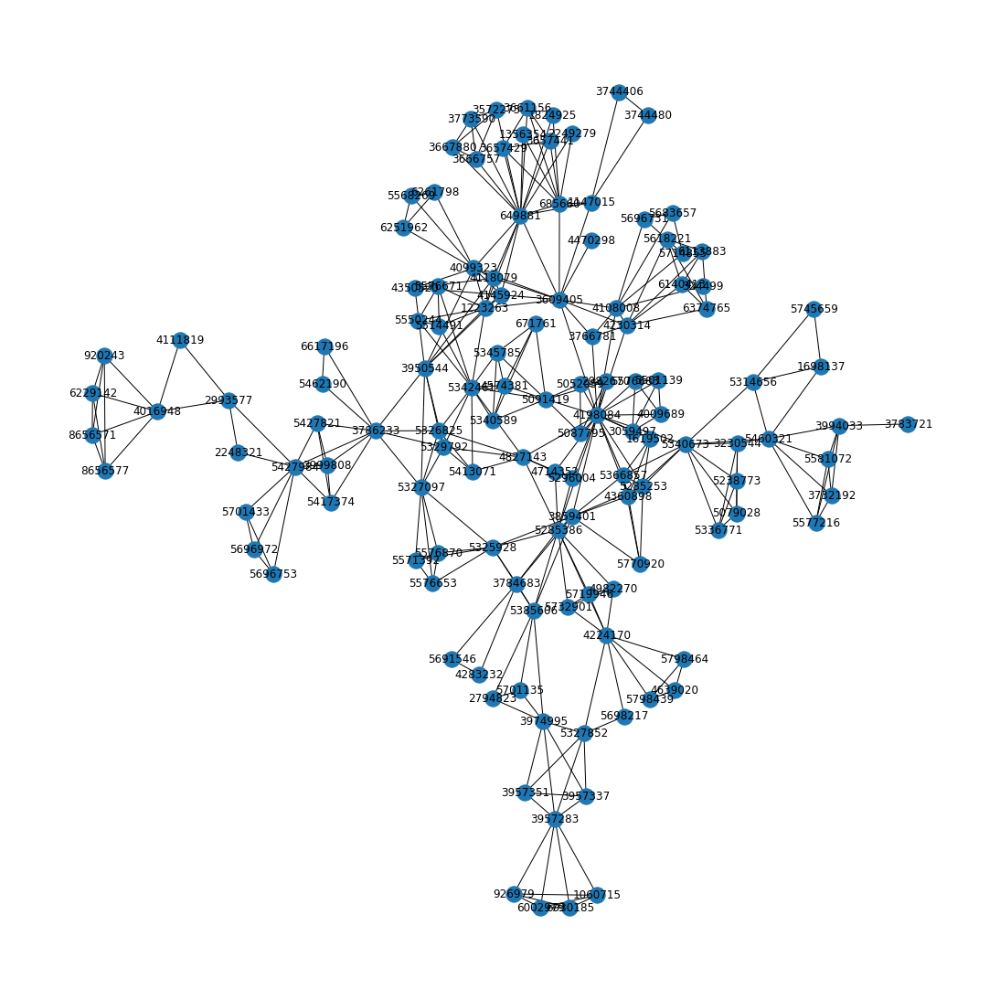

In [15]:
import matplotlib.pyplot as plt
selected_communities_list = [c for c in communities if 200 > len(c) > 10]
# Displaying an example of a community
plt.figure(figsize=(15,15))
c1 = ng.subgraph(selected_communities_list[0])
nx.draw_kamada_kawai(c1, with_labels=True)

Caluclating centerality Metrix for each community

In [16]:
import operator

def centerality(graph):
    nodes_count = len(graph.nodes())
    edges_count = len(graph.edges())
    
    d = nx.degree_centrality(graph)
    degree_centrality_most_central = max(dict(d).items(), key=operator.itemgetter(1))
    degree_centrality_avg = sum(d.values())/len(d)

    d = nx.pagerank(graph)
    pagerank_most_central = max(dict(d).items(), key=operator.itemgetter(1))
    pagerank_avg = sum(d.values())/len(d)

    d = nx.closeness_centrality(graph)
    closeness_centrality_most_central = max(dict(d).items(), key=operator.itemgetter(1))
    closeness_centrality_avg = sum(d.values())/len(d)
    
    return {"degree_centrality_most_central": degree_centrality_most_central,
            "degree_centrality_avg": degree_centrality_avg,
            "pagerank_most_central": pagerank_most_central,
            "pagerank_avg": pagerank_avg,
            "closeness_centrality_most_central": closeness_centrality_most_central,
            "closeness_centrality_avg": closeness_centrality_avg,
            "nodes_count": nodes_count,
            "edges_count": edges_count}


communities_centrality = []
for c in tqdm(selected_communities_list):
    if len(c) < 10: # skip small communities with only few nodes
        continue
    sub_ng = ng.subgraph(c)
    community_centrality = centerality(sub_ng)
    community_centrality["community"] = list(c)
    communities_centrality.append(community_centrality)

100%|██████████| 399/399 [00:04<00:00, 87.16it/s] 


communities_centrality is a list of the top 400 communities. For each community, multiple centrality measures where calculated:


1.   degree_centrality - Average degree, Most central node
2.   pagerank - Average pagerank, Most central node
3.   closeness_centrality - Average score, Most central node



In [17]:
print(communities_centrality[0])

{'degree_centrality_most_central': (4198084, 0.1746031746031746), 'degree_centrality_avg': 0.03949506311711029, 'pagerank_most_central': (4198084, 0.02816695331453177), 'pagerank_avg': 0.007874015748031496, 'closeness_centrality_most_central': (4198084, 0.36416184971098264), 'closeness_centrality_avg': 0.23687854594329377, 'nodes_count': 127, 'edges_count': 316, 'community': [5577216, 5340673, 926979, 4145924, 4827143, 5285386, 5568269, 2982670, 5701135, 5427984, 5581072, 671761, 3786233, 5514491, 5342461, 4470298, 3957283, 6002979, 5732901, 6261798, 5798439, 3783721, 3059497, 4639020, 5618221, 1619502, 3572275, 5087795, 4016948, 4350520, 5701433, 3609405, 2249279, 3999808, 5571392, 4118079, 5798464, 1356354, 3666757, 2794823, 5366857, 4099323, 3230544, 3974995, 1698137, 3957337, 6113883, 5091419, 685660, 1223263, 5314656, 5460321, 4283232, 3661156, 3957351, 5325928, 6030185, 1060715, 6617196, 6374765, 5427821, 5345785, 4714352, 5329792, 2248321, 5296004, 5285253, 5385606, 1147015, 571

## Teams in Competiotions

In [18]:
# I acknowledge that this method is rather crude, a recursive solution is prefferable.
# Yet it's sufficient for the current task.
from itertools import combinations, permutations

def split_list_to_triplets(l):
  triplets = []
  for i in range(len(l)):
    x = l[i]
    for j in range(len(l[i:])):
      y = l[i+j]
      if x==y:
        continue
      for k in range(len(l[i+j:])):
        z = l[i+j+k]
        if z==y or z==x:
          continue
        triplets.append((str(x),str(y),str(z)))
  return triplets

def split_list_to_quadruplets(l):
  quadruplets = []
  for i in range(len(l)):
    x = l[i]
    for j in range(len(l[i:])):
      y = l[i+j]
      if x==y:
        continue
      for k in range(len(l[i+j:])):
        z = l[i+j+k]
        if z==y or z==x:
          continue
        for o in range(len(l[i+j+k:])):
          w = l[i+j+k+o]
          if w==z or w==y or w==x:
            continue
          quadruplets.append((str(x),str(y),str(z),str(w)))
  return quadruplets

#Additional implementation
# from itertools import combinations, permutations

# def get_combinations(l, k):
#   combs = list(combinations(l,k))
#   res_l = []
#   for comb in combs:
#     res_l = res_l+list(permutations(comb))
#   return res_l 

Teams of 3 members, competing together for more then 10 competitions

In [19]:
triplets_lists = sf_big_teams["DistinctUserId"].apply(lambda r: split_list_to_triplets(r))
triplets = []
for triplets_list in tqdm(triplets_lists):
  triplets = triplets+triplets_list
triplets = tuple([tuple(triplet) for triplet in triplets])
# triplets_counter = dict(Counter(triplets))
# for triplet, counter in triplets_counter.items():
#   if counter>10:
#     print("Triplet: ", triplet, ",Copetition participated together: ", counter)

100%|██████████| 32626/32626 [00:32<00:00, 995.13it/s]


In [20]:
def comparator(l1, l2):
  equal = True
  if len(l1) != len(l2):
    return False
  for element1 in l1:
    if element1 not in l2:
      return False
  for element2 in l2:
    if element2 not in l1:
      return False
  return equal

def is_in_2(l1, lists):
  for l1_p in list(permutations(l1)):
    if l1_p in lists:
      return l1_p
  return None


In [21]:
counts = {}
for triplet in tqdm(triplets):
  triplet_is_in = is_in_2(triplet, counts.keys())
  if triplet_is_in:
    counts[triplet_is_in] += 1
  else:
    counts[triplet] = 1
for triplet, counter in counts.items():
  if counter>10:
    print("Triplet: ", triplet, ",Copetition participated together: ", counter)

100%|██████████| 189437/189437 [00:00<00:00, 404492.72it/s]


Triplet:  ('2696665', '2164736', '1832323') ,Copetition participated together:  14
Triplet:  ('1392911', '1393170', '1107109') ,Copetition participated together:  21
Triplet:  ('251266', '258363', '223160') ,Copetition participated together:  13
Triplet:  ('2224241', '622729', '599323') ,Copetition participated together:  12
Triplet:  ('4041944', '4766441', '4788618') ,Copetition participated together:  11
Triplet:  ('4041944', '4766441', '4765845') ,Copetition participated together:  11
Triplet:  ('4041944', '4788618', '4765845') ,Copetition participated together:  17
Triplet:  ('4766441', '4788618', '4765845') ,Copetition participated together:  11
Triplet:  ('3077080', '4661010', '4661162') ,Copetition participated together:  16
Triplet:  ('3077080', '4661010', '4661191') ,Copetition participated together:  16
Triplet:  ('3077080', '4661162', '4661191') ,Copetition participated together:  16
Triplet:  ('4661010', '4661162', '4661191') ,Copetition participated together:  16
Triplet: 

Teams of 4 members, competining together for more then 10 competitions

In [22]:
quadruplets_lists = sf_big_teams["DistinctUserId"].apply(lambda r: split_list_to_quadruplets(r))
quadruplets = []
for quadruplets_list in tqdm(quadruplets_lists):
  quadruplets = quadruplets+quadruplets_list
quadruplets = tuple([tuple(quadruplet) for quadruplet in quadruplets])
# quadruplets_counter = dict(Counter(quadruplets))
# for quadruplet, counter in quadruplets_counter.items():
#   if counter>10:
#     print("Quadruplet: ", quadruplet, ",Copetition participated together: ", counter)

100%|██████████| 32626/32626 [00:52<00:00, 625.21it/s]


In [23]:
counts = {}
for quadruplet in tqdm(quadruplets):
  quadruplet_is_in = is_in_2(quadruplet, counts.keys())
  if quadruplet_is_in:
    counts[quadruplet_is_in] += 1
  else:
    counts[quadruplet] = 1
for quadruplet, counter in counts.items():
  if counter>10:
    print("Quadruplet: ", quadruplet, ",Copetition participated together: ", counter)

100%|██████████| 365736/365736 [00:01<00:00, 188867.49it/s]

Quadruplet:  ('4041944', '4766441', '4788618', '4765845') ,Copetition participated together:  11
Quadruplet:  ('3077080', '4661010', '4661162', '4661191') ,Copetition participated together:  16
Quadruplet:  ('5484179', '5307813', '6425520', '6428342') ,Copetition participated together:  11
Quadruplet:  ('4660978', '4661041', '4660995', '4661121') ,Copetition participated together:  14
Quadruplet:  ('1039460', '1107109', '1393170', '1392911') ,Copetition participated together:  19
Quadruplet:  ('4471048', '4662375', '4662098', '4648702') ,Copetition participated together:  15
Quadruplet:  ('3602040', '3602071', '4321905', '2060096') ,Copetition participated together:  12
Quadruplet:  ('3597476', '4615104', '5484044', '3594546') ,Copetition participated together:  16
Quadruplet:  ('5589321', '3602040', '3602071', '4321905') ,Copetition participated together:  11
Quadruplet:  ('5896970', '4690343', '5989884', '4177309') ,Copetition participated together:  11


#Forum  Subjects
Topic Models

##Data Loading

In [24]:
import pandas as pd

In [25]:
df_forum_message = pd.read_csv('./Datasets/meta_kaggle/ForumMessages.csv')
df_forum_message['Message'] = df_forum_message['Message'].apply(lambda x: str(x))
df_forum_message = df_forum_message[["Id", "PostDate", "Message"]]
# select only every K row for better performance
k = 2
df_forum_message = df_forum_message.iloc[::k, :]
sf_forum_message = tc.SFrame(df_forum_message)
sf_forum_message.materialize()
sf_forum_message["PostDate"] = sf_forum_message["PostDate"].str_to_datetime(format='%m/%d/%Y %H:%M:%S')
sf_forum_message

Id,PostDate,Message
28,2010-05-12 04:39:30,Here are some papers thatanalyze Eurovision vo ...
1357,2010-12-01 21:46:53,Is there a time orderbetween the training and ...
1064,2010-10-24 23:38:59,"Hi all,<br><br>Just tolet you know that we ..."
1413,2010-11-24 02:44:04,I'm not sure you'veactually tried it. ...
1415,2010-11-24 02:44:04,mines between 5.7 and 5.9seconds. &nbsp;Sure ...
1417,2010-11-24 02:44:04,"just read your questionagain, and i think i ..."
1423,2010-11-24 02:44:04,Stupid Javaimplementation like t ...
1066,2010-10-24 23:38:59,"Apologies, I hadn'tantipicated that this ..."
1068,2010-10-24 23:38:59,Just another comment: wehave the logistical i ...
1070,2010-10-24 23:38:59,"Jeff, we must have postedsimultaneously. You r ..."


##Preprocess

In [26]:
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt') 
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [27]:
import re

clean_re = re.compile('<.*?>') 
def clean_text(text):
  cleantext = re.sub(clean_re, '', text)
  return cleantext

In [28]:
sf_forum_message["Message"] = sf_forum_message["Message"].apply(lambda r: clean_text(r))

In [29]:
from nltk.stem.porter import *
from functools import lru_cache
from nltk.corpus import stopwords

stop_words_set = set(stopwords.words("english"))
stemmer = PorterStemmer()

def skip_word(w):
  if len(w) <2:
      return True
  if w.isdigit():
      return True
  if w in stop_words_set or stemmer.stem(w) in stop_words_set:
      return True
  return False


@lru_cache(maxsize=None)
def word_stemming(w):
    return stemmer.stem(w)



Slicing the sf by year

In [30]:
import datetime


def slice_sf(sf, start, end, column_name):
  sf_sliced = sf[start <= sf[column_name]]
  sf_sliced = sf_sliced[sf_sliced[column_name] <= end]
  sf_sliced.materialize()
  return sf_sliced

years = list(range(2010, 2023))
sf_forum_message_years_dict = {}
for i in range(len(years)):
  start_date = datetime.date(years[i], 1, 1)
  end_date = datetime.date(years[i], 12, 31)
  sf_forum_message_years_dict[years[i]] = {"sf": slice_sf(sf_forum_message, start_date, end_date, "PostDate")}

##Topic Models
By year

In [31]:
for year, sf_forum_message_year_dict in sf_forum_message_years_dict.items():
  docs = tc.text_analytics.count_words(sf_forum_message_year_dict["sf"]["Message"])
  docs = docs.apply(lambda d: {w:v for w, v in d.items() if not skip_word(w)})
  topic_model = tc.topic_model.create(docs, num_topics=50)
  topics_sf = topic_model.topics

  sf_forum_message_years_dict[year]["topic_model"] = topic_model
  sf_forum_message_years_dict[year]["topics_sf"] = topics_sf
  

Learning a topic model

Number of documents       763

Vocabulary size      5621

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 88.857ms      | 4.25713e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents      2878

Vocabulary size     12371

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 268.044ms     | 4.84185e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents      4554

Vocabulary size     15943

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 335.814ms     | 4.84074e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents      6901

Vocabulary size     18300

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 533.49ms      | 4.72438e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents      8438

Vocabulary size     20936

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 640.374ms     | 4.12322e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents     15480

Vocabulary size     26985

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 1.14s         | 4.55898e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents     23095

Vocabulary size     32256

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 1.45s         | 4.74812e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents     50000

Vocabulary size     46386

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 2.25s         | 4.69869e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents     80527

Vocabulary size     59333

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 3.41s         | 4.4902e+06     | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents    110359

Vocabulary size     72777

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 4.23s         | 4.45401e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents    184330

Vocabulary size     99496

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 6.87s         | 4.64312e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents    212638

Vocabulary size    109679

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 7.17s         | 4.41361e+06    | 0               |

+-----------+---------------+----------------+-----------------+

Learning a topic model

Number of documents     12343

Vocabulary size     16587

Running collapsed Gibbs sampling

+-----------+---------------+----------------+-----------------+

| Iteration | Elapsed Time  | Tokens/Second  | Est. Perplexity |

+-----------+---------------+----------------+-----------------+

| 10        | 443.993ms     | 4.06902e+06    | 0               |

+-----------+---------------+----------------+-----------------+

In [32]:
def get_topic_best_match_words(topic_sf, topic_num,n):
    d = {r['vocabulary']: r['topic_probabilities'][topic_num] for r in topic_sf}
    l = sorted(d.items(), key=operator.itemgetter(1), reverse=True)
    return l[:n]

def get_topics_best_match_words(topic_sf,n):
  topics_count = len(topics_sf["topic_probabilities"][0])
  best_match_words = []
  for topic_num in tqdm(range(topics_count)):
    best_match_words_curr = get_topic_best_match_words(topic_sf, topic_num, n)
    best_match_words_curr = [pair for pair in best_match_words_curr]
    best_match_words.append(best_match_words_curr)
  return best_match_words

import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
%matplotlib inline


def draw_word_cloud(freq_dic, i, title):
    stopwords = set(STOPWORDS)
    wordcloud = WordCloud(width = 800, height = 800, 
                    # background_color ='black', 
                    stopwords = stopwords, 
                    min_font_size = 10)#.generate(comment_words)
    
    # using the subject frquencies
    wordcloud.generate_from_frequencies(frequencies=freq_dic["score"])
    fig = plt.figure(figsize = (12, 12), facecolor = None) 
    fig.suptitle(title, fontsize=20, fontweight='bold')
    plt.imshow(wordcloud)
    plt.savefig(f'./images/wordcloud{i}.png')

100%|██████████| 50/50 [00:05<00:00,  9.98it/s]


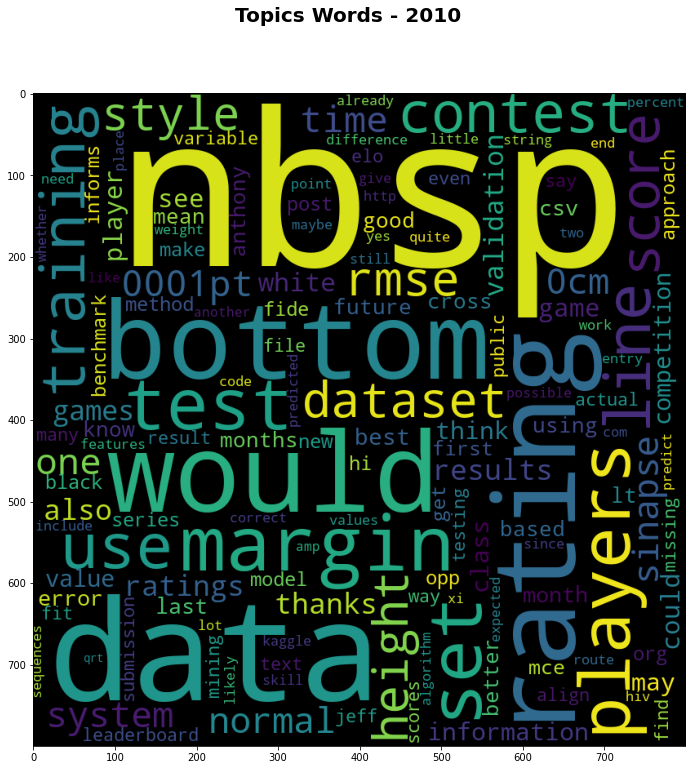

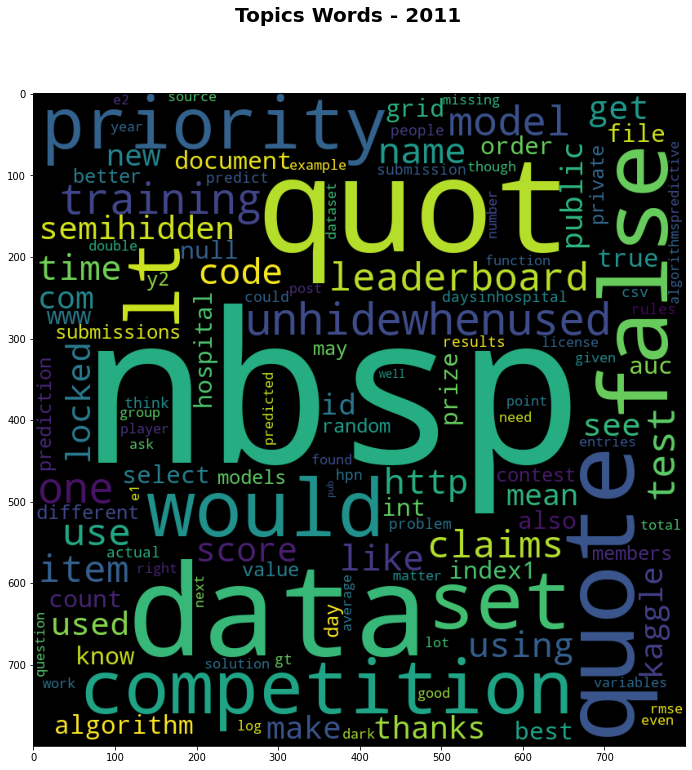

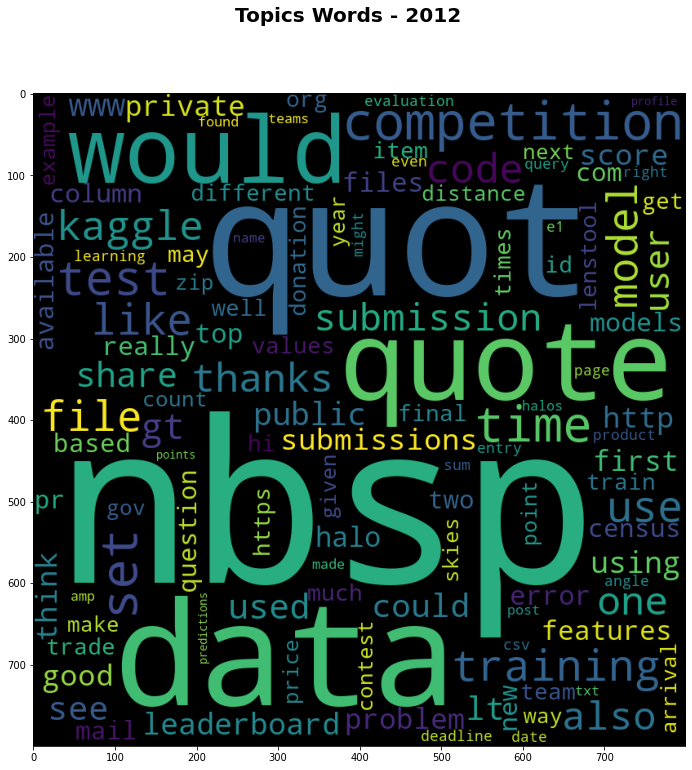

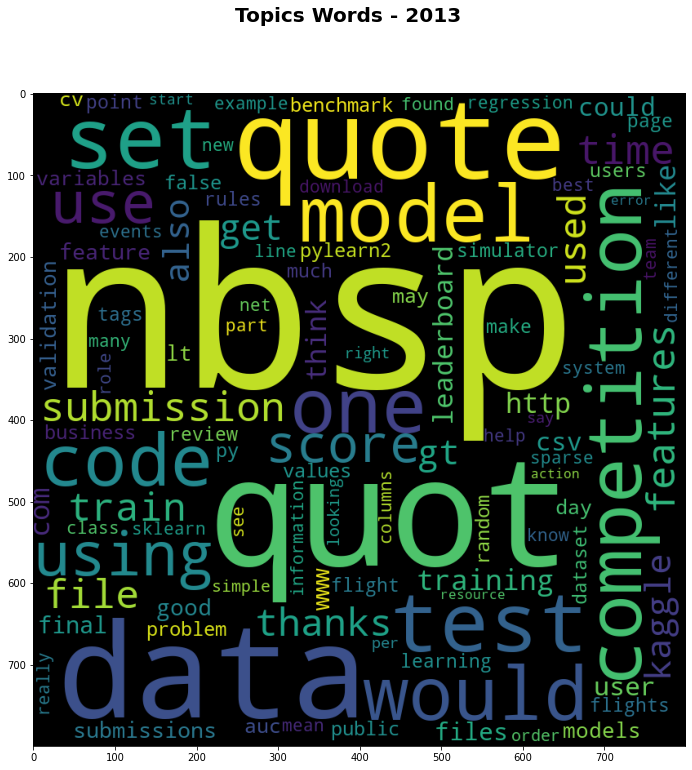

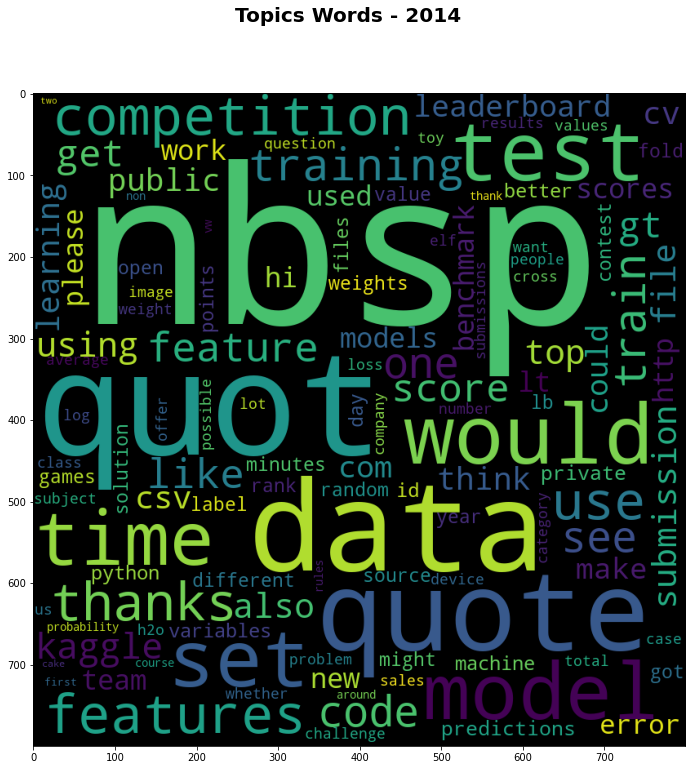

...

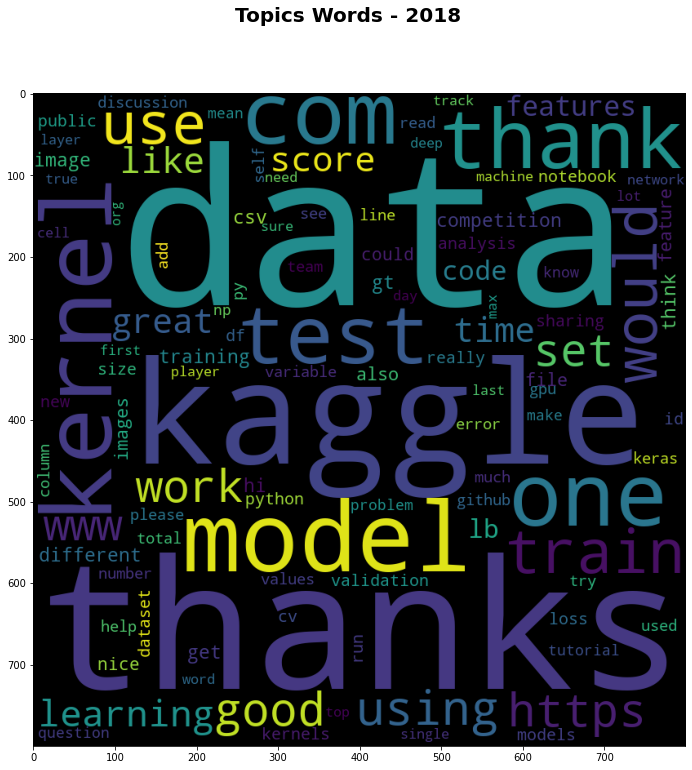

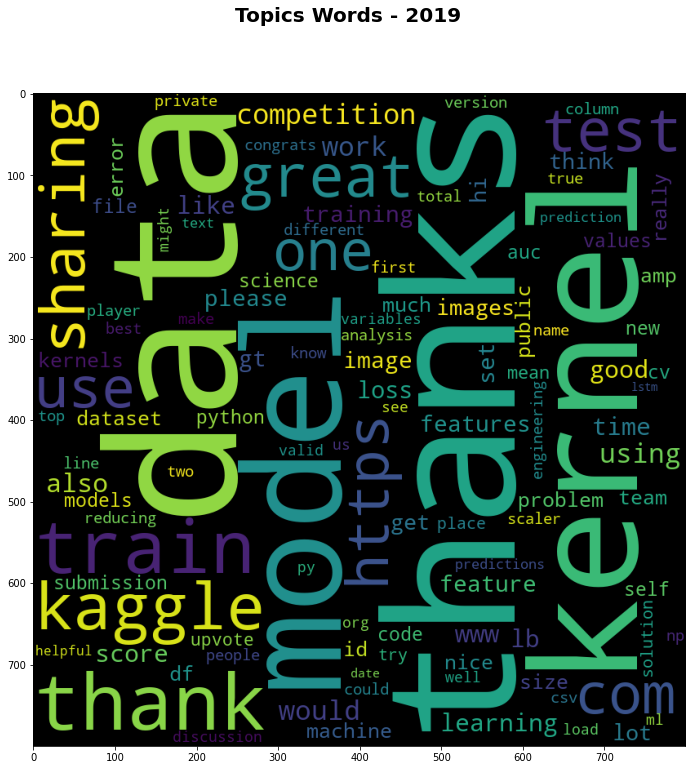

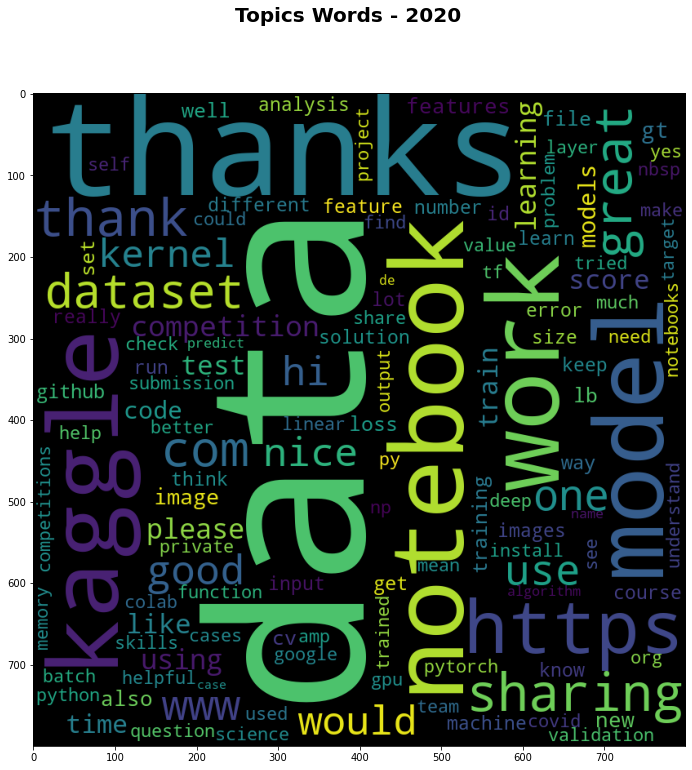

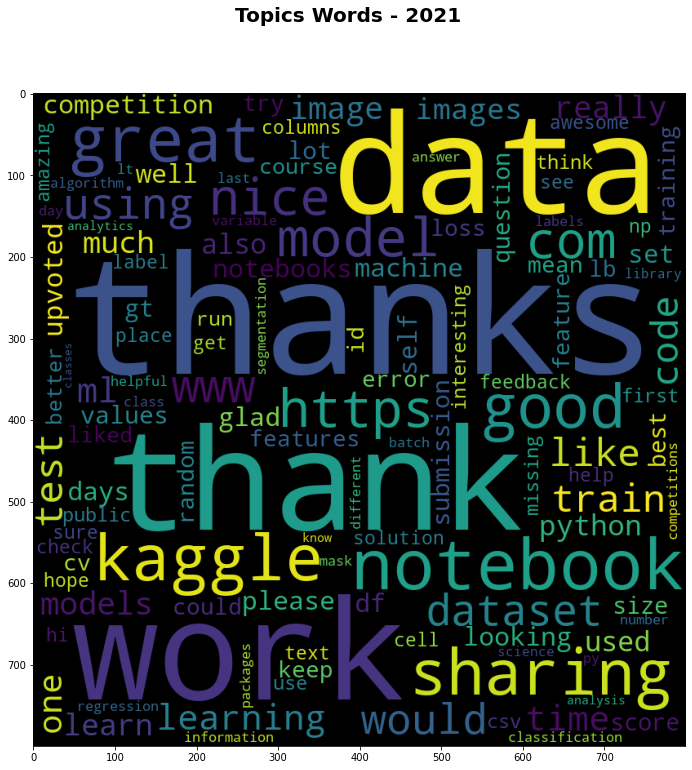

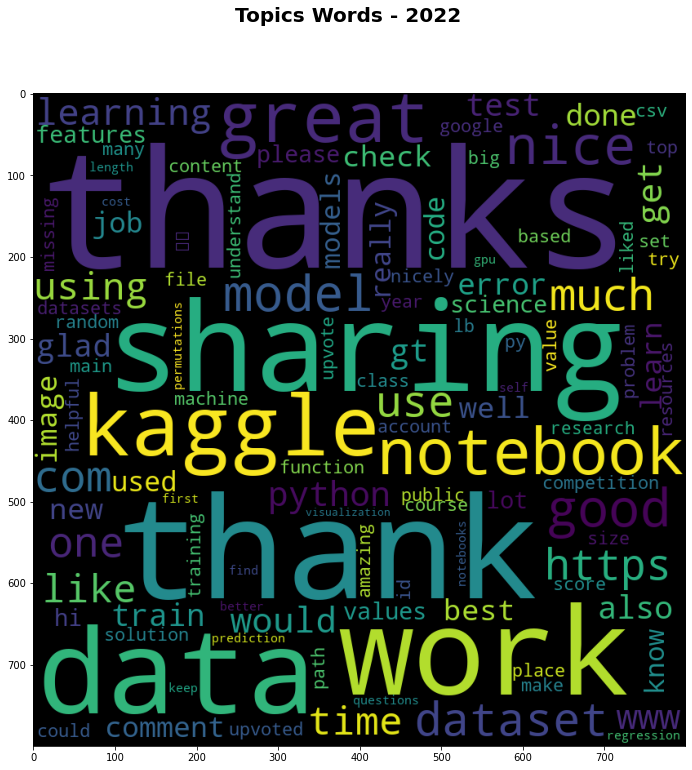

In [33]:
for year, sf_forum_message_year_dict in sf_forum_message_years_dict.items():
  topics_sf = sf_forum_message_year_dict["topics_sf"]
  topics_best_match_words = get_topics_best_match_words(topics_sf,4)
  # topic_words_dict = {"word": [], "score": []}
  words_dict = {}
  for i in range(len(topics_best_match_words)):
    topic_words = topics_best_match_words[i]
    for j in range(len(topic_words)):
      # topic_words_dict["word"].append(topic_words[j][0])
      # topic_words_dict["score"].append(1/(j+1))
      if topic_words[j][0] in words_dict:
        words_dict[topic_words[j][0]] += topic_words[j][1]
      else:
        words_dict[topic_words[j][0]] = topic_words[j][1]
        
  # topic_words = pd.DataFrame(topic_words_dict).set_index("word")
  topic_words_no_repetitions = pd.DataFrame({"word": words_dict.keys(), "score": words_dict.values()}).set_index("word")
  draw_word_cloud(topic_words_no_repetitions, year, f"Topics Words - {year}")

In [34]:
import cv2
import os

image_folder = 'images'
video_name = './videos/wordcloud_video.avi'

images = sorted([img for img in os.listdir(image_folder) if img.endswith(".png")])
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()

In [35]:
from moviepy.editor import *

path="/content/videos/wordcloud_video.avi" 

clip=VideoFileClip(path)
clip.ipython_display(width=500)

 93%|█████████▎| 13/14 [00:00<00:00, 76.72it/s]


##Code

In [36]:
!mkdir ./images_code
!mkdir ./videos_code

mkdir: cannot create directory ‘./images_code’: File exists
mkdir: cannot create directory ‘./videos_code’: File exists


Filter words that are related to coding
the following data set is used **only** to extract names of coding languages and packages (though it could be used to complete the task). There is an additional terms list, however Idecided to use the more comprehansive one.

In [37]:
# Creating a dataset directory
!mkdir ./Datasets/programming_lang

# download the dataset from Kaggle and unzip it
!kaggle datasets download jaimevalero/developers-and-programming-languages -f user-languages.csv -p ./Datasets/programming_lang/
!unzip ./Datasets/programming_lang/*.zip  -d ./Datasets/programming_lang

import csv
# pd.read_csv("./Datasets/programming_lang/user-languages.csv")
with open("./Datasets/programming_lang/user-languages.csv", newline='') as f:
  reader = csv.reader(f)
  prog_lang_list = next(reader)[1:]
print(prog_lang_list)

mkdir: cannot create directory ‘./Datasets/programming_lang’: File exists
user-languages.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  ./Datasets/programming_lang/user-languages.csv.zip
replace ./Datasets/programming_lang/user-languages.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N
['assembly', 'batchfile', 'c', 'c#', 'c++', 'clojure', 'coffeescript', 'css', 'elixir', 'emacs lisp', 'go', 'haskell', 'html', 'java', 'javascript', 'jupyter notebook', 'kotlin', 'lua', 'matlab', 'objective-c', 'objective-c++', 'ocaml', 'perl', 'php', 'powershell', 'purebasic', 'python', 'rascal', 'ruby', 'rust', 'scala', 'shell', 'swift', 'tex', 'typescript', 'vim script', 'vue', '1-wire', '2d', '3d', '3d-engine', '3d-game-engine', 'accessibility', 'accordion', 'acme', 'acme-client', 'activejob', 'activerecord', 'activity', 'activity-stream', 'actor-model', 'adc', 'addons', 'admin', 'admin-dashboard', 'admin-template', 'admin-theme', 'admin-ui', 'ado-net

In [38]:
# prog_lang_list_2 = ['Abap', 'Ada', 'C', 'C++', 'C#', 'Cobol', 'Dart', 'Delphi', 'Go', 'Groovy',
#        'Haskell', 'Java', 'JavaScript', 'Julia', 'Kotlin', 'Lua', 'Matlab', 'Objective-C', 'Perl', 
#        'PHP', 'Python', 'R', 'Ruby', 'Rust', 'Scala', 'Swift', 'TypeScript', 'VBA', 'Visual Basic',
#        'pandas', 'numpy', 'matplotlib.pyplot', 'seaborn', 'os', 'train', 'gc', 'time', 'tensorflow',
#        'warnings', 'random', 'bq', 'cv2', 'roc', 'sys', '', 'xgboost', 'datetime', 'lightgbm', 're',
#        'KFold', 'tqdm', 'glob', 'Sequential', 'Series', 'StandardScaler', 'math', 'Dense', 'matplotlib',
#        'LabelEncoder', 'mean', 'LogisticRegression', 'pyplot', 'check', 'RandomForestRegressor', 
#        'sklearn', 'Image', 'keras', 'Tokenizer', 'json', 'scipy', 'cross', 'LinearRegression', 
#        'csv', 'imread', 'stats', 'pad', 'TfidfVectorizer', 'preprocessing', 'DecisionTreeClassifier']
# prog_lang_list_2 = [x.lower() for x in prog_lang_list_2]

In [39]:
def remove_out_of_vocab_words(r, vocab):
  r_clean = []
  for w in r.split(" "):
    if w in vocab or w.lower() in vocab:
      r_clean.append(w.lower())
  return " ".join(r_clean)

In [40]:
import plotly.express as px


for year, sf_forum_message_year_dict in tqdm(sf_forum_message_years_dict.items()):
  sf = sf_forum_message_year_dict["sf"]
  # Filtering out the words unrelated to programming
  sf["Message"] = sf["Message"].apply(lambda r: remove_out_of_vocab_words(r, prog_lang_list))
  sf["Message"] = sf["Message"].apply(lambda r: r if len(r)>0 else None)
  sf = sf.dropna()
  sf.materialize()

  #Get Bag-of-words counting for each message
  sf['words_dict'] = tc.text_analytics.count_words(sf['Message'])
  sf.materialize()

  #Get counter for each word
  words_dict = Counter()
  for words_count in sf["words_dict"]:
    words_dict = words_dict + Counter(words_count)
  words_dict = dict(words_dict)
  words = []
  counts = []
  for word, count in words_dict.items():
    words.append(word)
    counts.append(count)
  #Display bar plot based on counts
  sf_words_counts = tc.SFrame({"word": words, "count": counts})
  sf_words_counts = sf_words_counts.dropna()
  sf_words_counts.materialize()
  sf_words_counts = sf_words_counts.sort("count", ascending=False)

  fig = px.bar(sf_words_counts[:20], x='word', y='count', title=f'{year} - Programming Packages Counts')
  fig.write_image(f"images_code/fig_{year}.png")
  fig.show()

  0%|          | 0/13 [00:00<?, ?it/s]

  8%|▊         | 1/13 [00:06<01:16,  6.37s/it]

 15%|█▌        | 2/13 [00:19<01:51, 10.10s/it]

 23%|██▎       | 3/13 [00:33<02:00, 12.05s/it]

 31%|███       | 4/13 [00:55<02:25, 16.12s/it]

 38%|███▊      | 5/13 [01:22<02:39, 20.00s/it]

 46%|████▌     | 6/13 [02:10<03:25, 29.31s/it]

 54%|█████▍    | 7/13 [03:14<04:04, 40.71s/it]

 62%|██████▏   | 8/13 [04:53<04:56, 59.37s/it]

 69%|██████▉   | 9/13 [07:17<05:43, 85.94s/it]

 77%|███████▋  | 10/13 [10:15<05:42, 114.27s/it]

 85%|████████▍ | 11/13 [15:09<05:38, 169.21s/it]

 92%|█████████▏| 12/13 [19:58<03:25, 205.80s/it]

100%|██████████| 13/13 [20:15<00:00, 93.48s/it] 


In [41]:
import cv2
import os

image_folder = 'images_code'
video_name = './videos_code/code_bar_video.avi'

images = sorted([img for img in os.listdir(image_folder) if img.endswith(".png")])
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()

**Some of the words are packages and some are programming languages.**

In [42]:
from moviepy.editor import *

path="/content/videos_code/code_bar_video.avi" 

clip=VideoFileClip(path)
clip.ipython_display(width=500)

 93%|█████████▎| 13/14 [00:00<00:00, 132.48it/s]


#**Question 3**

##Data Loading

In [43]:
# Creating a dataset directory
!mkdir ./Datasets/olympics

# download the dataset from Kaggle and unzip it
!kaggle datasets download heesoo37/120-years-of-olympic-history-athletes-and-results -f athlete_events.csv -p ./Datasets/olympics/
!unzip ./Datasets/olympics/*.zip  -d ./Datasets/olympics



 92% 5.00M/5.43M [00:00<00:00, 18.0MB/s]
100% 5.43M/5.43M [00:00<00:00, 18.0MB/s]
Archive:  ./Datasets/olympics/athlete_events.csv.zip
  inflating: ./Datasets/olympics/athlete_events.csv  


##Aggrigative Achievements

In [44]:
import turicreate.aggregate as agg
sf_olympics = tc.SFrame.read_csv("./Datasets/olympics/athlete_events.csv")
#Fill na with Did Not Win - DNW
sf_olympics['Medal'] = sf_olympics['Medal'].fillna('DNW')
sf_olympics = sf_olympics[["ID", "Name","Medal"]]

def convert_medal_to_score(medal):
  if medal == "Gold":
    return 3
  if medal == "Silver":
    return 2
  if medal == "Bronze":
    return 1
  else:
    return 0

sf_olympics["Medal_score"] = sf_olympics["Medal"].apply(lambda r: convert_medal_to_score(r))

sf_olympics_scores = sf_olympics.groupby(["ID", "Name"], {"total_medal_score": agg.SUM('Medal_score')}, {"avg_medal_score": agg.AVG('Medal_score')})
sf_olympics_scores_sort_total = sf_olympics_scores.sort("total_medal_score", ascending=False)
sf_olympics_scores_sort_avg = sf_olympics_scores.sort("avg_medal_score", ascending=False)


Finished parsing file /content/Datasets/olympics/athlete_events.csv

Parsing completed. Parsed 100 lines in 2.02171 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,int,int,float,str,str,str,int,str,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/Datasets/olympics/athlete_events.csv

Parsing completed. Parsed 271116 lines in 1.41731 secs.

In [45]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

k=15

fig = make_subplots(rows=2, cols=1, subplot_titles=["Based on Total Medals Score", "Based on Mean Medals Score"])

fig.add_trace(
    go.Bar(x=list(sf_olympics_scores_sort_total["Name"])[:k], y=list(sf_olympics_scores_sort_total["total_medal_score"])[:k]),
    row=1, col=1)

fig.add_trace(
    go.Bar(x=list(sf_olympics_scores_sort_avg["Name"])[:k], y=list(sf_olympics_scores_sort_avg["avg_medal_score"])[:k]),
    row=2, col=1
)

fig.update_layout(height=800, width=1200, title_text="Top Performing Athletes", showlegend=False)
fig.show()

##Predicting Sucess
In this section a model is trained to predict an athlete achievement based on the physical features, sport type, and the athlete's country.

**If a sufficiently trained model predicts that an athlete would loss, and yet the athlete wins a gold medal, this is an extra ordinary achievement.**
This holds to the other direction as well. If a trained model predicts that the athlete would win a gold medal, and the athlete losses all medals, then this is a disappointing loss.

In [46]:
sf_olympics = tc.SFrame.read_csv("./Datasets/olympics/athlete_events.csv")
#Fill na with Did Not Win - DNW
sf_olympics['Medal'] = sf_olympics['Medal'].fillna('DNW')


Finished parsing file /content/Datasets/olympics/athlete_events.csv

Parsing completed. Parsed 100 lines in 2.02365 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,int,int,float,str,str,str,int,str,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /content/Datasets/olympics/athlete_events.csv

Parsing completed. Parsed 271116 lines in 1.36272 secs.

In [47]:
sf_olympics = sf_olympics[["Sex", "Age", "Height", "Weight", "Team", "Year", "Sport" ,"Event" ,"Medal"]]

In [48]:
sf_olympics['Event_words_counts'] = tc.text_analytics.count_words(sf_olympics['Event'])
sf_olympics.materialize()
sf_olympics

Sex,Age,Height,Weight,Team,Year,Sport,Event,Medal
M,24,180,80.0,China,1992,Basketball,Basketball Men'sBasketball ...,DNW
M,23,170,60.0,China,2012,Judo,Judo Men's Extra-Lightweight ...,DNW
M,24,None,None,Denmark,1920,Football,Football Men's Football,DNW
M,34,None,None,Denmark/Sweden,1900,Tug-Of-War,Tug-Of-War Men's Tug-Of-War ...,Gold
F,21,185,82.0,Netherlands,1988,Speed Skating,Speed Skating Women's 500metres ...,DNW
F,21,185,82.0,Netherlands,1988,Speed Skating,"Speed Skating Women's1,000 metres ...",DNW
F,25,185,82.0,Netherlands,1992,Speed Skating,Speed Skating Women's 500metres ...,DNW
F,25,185,82.0,Netherlands,1992,Speed Skating,"Speed Skating Women's1,000 metres ...",DNW
F,27,185,82.0,Netherlands,1994,Speed Skating,Speed Skating Women's 500metres ...,DNW
F,27,185,82.0,Netherlands,1994,Speed Skating,"Speed Skating Women's1,000 metres ...",DNW


Taining Classification Model
**NOTE** 
The data is imbalanced, therefor I will regard the auc metric as the performance metric

In [53]:
train, test  = sf_olympics.random_split(0.8)
print(f"Train size {len(train)}\nTest size: {len(test)}" )
features_list = ["Sex", "Age", "Height", "Weight", "Team", "Year", "Sport" ,"Event" , "Event_words_counts"]
cls = tc.boosted_trees_classifier.create(train,features=features_list, target="Medal")

Train size 217306
Test size: 53810
PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 206440

Number of classes           : 4

Number of feature columns   : 9

Number of unpacked features : 415

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.891174     | 0.861660          | 0.859010            | 1.025325          | 1.027194            |

| 2         | 1.782040     | 0.861548          | 0.858826            | 0.836480          | 0.839519            |

| 3         | 2.686964     | 0.861790          | 0.858642            | 0.720613          | 0.724385            |

| 4         | 3.594612     | 0.861534          | 0.858366            | 0.646749          | 0.651386            |

| 5         | 4.498908     | 0.861383          | 0.858366            | 0.598054          | 0.603343            |

| 10        | 9.043133     | 0.861694          | 0.858918            | 0.507554          | 0.516099            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Evaluating 

In [54]:
results = cls.evaluate(test)
print(results)

{'accuracy': 0.8609552127857275, 'auc': 0.7543919857739741, 'confusion_matrix': Columns:
	target_label	str
	predicted_label	str
	count	int

Rows: 12

Data:
+--------------+-----------------+-------+
| target_label | predicted_label | count |
+--------------+-----------------+-------+
|     DNW      |       DNW       | 45868 |
|    Bronze    |       Gold      |   17  |
|     Gold     |       Gold      |  351  |
|     DNW      |       Gold      |   3   |
|    Silver    |       Gold      |   64  |
|     Gold     |       DNW       |  2310 |
|    Bronze    |      Bronze     |   36  |
|    Silver    |       DNW       |  2469 |
|     Gold     |      Bronze     |   3   |
|    Bronze    |       DNW       |  2615 |
+--------------+-----------------+-------+
[12 rows x 3 columns]
Note: Only the head of the SFrame is printed.
You can use print_rows(num_rows=m, num_columns=n) to print more rows and columns., 'f1_score': 0.30824331407256306, 'log_loss': 0.5131173847939275, 'precision': 0.89440919632

Analyzing the confusion_matrix produced we can draw our conclutions on exeptional achievements.


There are around 2000 athletes who were able to win a gold medal, even though the model predicted that they would loss. All of thhese wins could be considered remarkable. If the performances of the model were better, we could more confidently determine. 

From the opposite perspective, there were very few (3) athletes for which the model predicted gold medal, yet they didn't win any medal.


In [55]:
results["confusion_matrix"].print_rows(14,3)

+--------------+-----------------+-------+
| target_label | predicted_label | count |
+--------------+-----------------+-------+
|     DNW      |       DNW       | 45868 |
|    Bronze    |       Gold      |   17  |
|     Gold     |       Gold      |  351  |
|     DNW      |       Gold      |   3   |
|    Silver    |       Gold      |   64  |
|     Gold     |       DNW       |  2310 |
|    Bronze    |      Bronze     |   36  |
|    Silver    |       DNW       |  2469 |
|     Gold     |      Bronze     |   3   |
|    Bronze    |       DNW       |  2615 |
|    Silver    |      Silver     |   73  |
|    Bronze    |      Silver     |   1   |
+--------------+-----------------+-------+
[12 rows x 3 columns]



In [52]:
import math
import plotly.express as px

confusion_matrix = results["confusion_matrix"]
confusion_matrix["log_count"] = confusion_matrix["count"].apply(lambda r: math.log(r))
fig = px.density_heatmap(confusion_matrix, x="target_label", y="predicted_label", z="log_count", text_auto=True)
fig.show()